In [1]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
import torch.optim as optim
import torchvision.datasets as datasets
import imageio
import numpy as np
import matplotlib
from torchvision.utils import make_grid, save_image
from torch.utils.data import DataLoader
from matplotlib import pyplot as plt
from tqdm import tqdm

# Define learning parameters

In [2]:
# learning parameters
batch_size = 512
epochs = 100
sample_size = 64 # fixed sample size for generator
nz = 128 # latent vector size
k = 1 # number of steps to apply to the discriminator
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Prepare training dataset

In [3]:
transform = transforms.Compose([
                                transforms.ToTensor(),
                                transforms.Normalize((0.5,),(0.5,)),
])
to_pil_image = transforms.ToPILImage()

# Make input, output folders
!mkdir -p input
!mkdir -p outputs

# Load train data
train_data = datasets.MNIST(
    root='input/data',
    train=True,
    download=True,
    transform=transform
)
train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)

100%|██████████| 9912422/9912422 [00:00<00:00, 27007649.87it/s]


Extracting input/data/MNIST/raw/train-images-idx3-ubyte.gz to input/data/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 111235715.17it/s]


Extracting input/data/MNIST/raw/train-labels-idx1-ubyte.gz to input/data/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 23450058.99it/s]


Extracting input/data/MNIST/raw/t10k-images-idx3-ubyte.gz to input/data/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 18955750.02it/s]

Extracting input/data/MNIST/raw/t10k-labels-idx1-ubyte.gz to input/data/MNIST/raw



# Generator

In [4]:
class Generator(nn.Module):
    def __init__(self, nz):
        super(Generator, self).__init__()
        self.nz = nz
        self.main = nn.Sequential(
            nn.Linear(self.nz, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2),
            nn.Linear(1024, 784),
            nn.Tanh(),
        )
    def forward(self, x):
        return self.main(x).view(-1, 1, 28, 28)

# Discriminator

In [5]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.n_input = 784
        self.main = nn.Sequential(
            nn.Linear(self.n_input, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(256, 1),
            nn.Sigmoid(),
        )
    def forward(self, x):
        x = x.view(-1, 784)
        return self.main(x)

In [11]:
generator = Generator(nz).to(device)
discriminator = Discriminator().to(device)
print('##### GENERATOR #####')
print(generator)
print('######################')
print('\n##### DISCRIMINATOR #####')
print(discriminator)
print('######################')

##### GENERATOR #####
Generator(
  (main): Sequential(
    (0): Linear(in_features=128, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Linear(in_features=256, out_features=512, bias=True)
    (3): LeakyReLU(negative_slope=0.2)
    (4): Linear(in_features=512, out_features=1024, bias=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Linear(in_features=1024, out_features=784, bias=True)
    (7): Tanh()
  )
)
######################

##### DISCRIMINATOR #####
Discriminator(
  (main): Sequential(
    (0): Linear(in_features=784, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=1024, out_features=512, bias=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Dropout(p=0.3, inplace=False)
    (6): Linear(in_features=512, out_features=256, bias=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Dropout(p=0.3, inplace=False)
    (9): Linear(in_features=256, out_features=1

# Tools for training

In [12]:
# optimizers
optim_g = optim.Adam(generator.parameters(), lr=0.0002)
optim_d = optim.Adam(discriminator.parameters(), lr=0.0002)
# loss function
criterion = nn.BCELoss() # Binary Cross Entropy loss
losses_g = [] # to store generator loss after each epoch
losses_d = [] # to store discriminator loss after each epoch
images = [] # to store images generatd by the generator
def label_real(size):
    data = torch.ones(size, 1)
    return data.to(device)
# to create fake labels (0s)
def label_fake(size):
    data = torch.zeros(size, 1)
    return data.to(device)
def create_noise(sample_size, nz):
    return torch.randn(sample_size, nz).to(device)

# to save the images generated by the generator
def save_generator_image(image, path):
    save_image(image, path)

noise = create_noise(sample_size, nz) #torch.Size([512, 1, 1, 1])

In [13]:
# loss function
criterion = nn.BCELoss() # Binary Cross Entropy loss

In [10]:
losses_g = [] # to store generator loss after each epoch
losses_d = [] # to store discriminator loss after each epoch
images = [] # to store images generatd by the generator

In [11]:
# to create real labels (1s)
def label_real(size):
    data = torch.ones(size, 1)
    return data.to(device)
# to create fake labels (0s)
def label_fake(size):
    data = torch.zeros(size, 1)
    return data.to(device)


In [12]:
# function to create the noise vector
def create_noise(sample_size, nz):
    return torch.randn(sample_size, nz).to(device)

In [13]:
# to save the images generated by the generator
def save_generator_image(image, path):
    save_image(image, path)

In [14]:
# create the noise vector - fixed to track how GAN is trained.
noise = create_noise(sample_size, nz) #torch.Size([512, 1, 1, 1])

Training loop - change in loss function

118it [00:16,  7.13it/s]                         


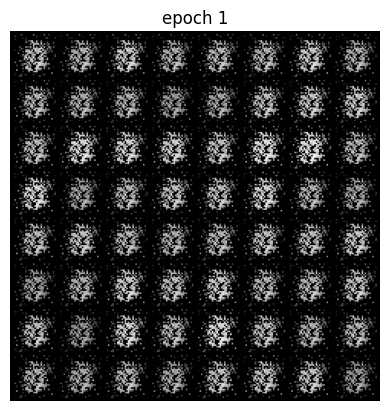

Epoch 1 of 100
Generator loss: -0.24190523, Discriminator loss: 0.43716169


118it [00:16,  7.23it/s]                         


Epoch 2 of 100
Generator loss: -0.00001272, Discriminator loss: 0.00002769


118it [00:16,  7.20it/s]                         


Epoch 3 of 100
Generator loss: -0.00001289, Discriminator loss: 0.00002310


118it [00:16,  7.01it/s]                         


Epoch 4 of 100
Generator loss: -0.00001280, Discriminator loss: 0.00002164


118it [00:16,  7.12it/s]                         


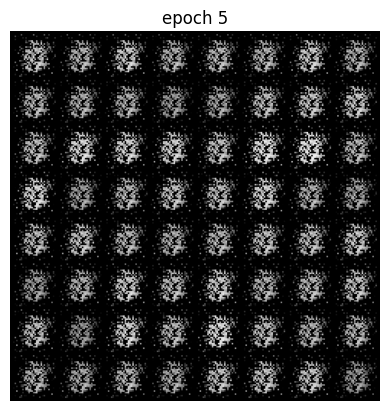

Epoch 5 of 100
Generator loss: -0.00001253, Discriminator loss: 0.00002161


118it [00:17,  6.80it/s]                         


Epoch 6 of 100
Generator loss: -0.00001291, Discriminator loss: 0.00001880


118it [00:16,  7.01it/s]                         


Epoch 7 of 100
Generator loss: -0.00001190, Discriminator loss: 0.00001873


118it [00:16,  7.08it/s]                         


Epoch 8 of 100
Generator loss: -0.00001219, Discriminator loss: 0.00001639


118it [00:16,  7.04it/s]                         


Epoch 9 of 100
Generator loss: -0.00001195, Discriminator loss: 0.00001691


118it [00:16,  7.00it/s]                         


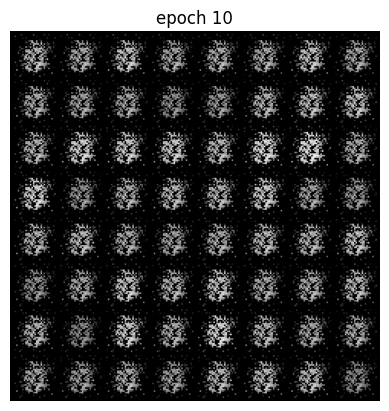

Epoch 10 of 100
Generator loss: -0.00001165, Discriminator loss: 0.00001585


118it [00:17,  6.89it/s]                         


Epoch 11 of 100
Generator loss: -0.00001282, Discriminator loss: 0.00001756


118it [00:17,  6.72it/s]                         


Epoch 12 of 100
Generator loss: -0.00001620, Discriminator loss: 0.00002169


118it [00:16,  7.11it/s]                         


Epoch 13 of 100
Generator loss: -0.00018804, Discriminator loss: 0.00434567


118it [00:16,  7.05it/s]                         


Epoch 14 of 100
Generator loss: -0.00000003, Discriminator loss: 0.00013302


118it [00:16,  6.99it/s]                         


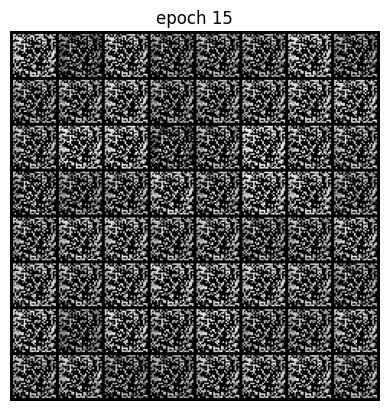

Epoch 15 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.73it/s]                         


Epoch 16 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.54it/s]                         


Epoch 17 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.89it/s]                         


Epoch 18 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.82it/s]                         


Epoch 19 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.91it/s]                         


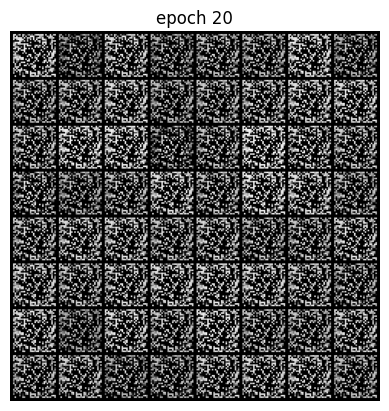

Epoch 20 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.77it/s]                         


Epoch 21 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.59it/s]                         


Epoch 22 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.75it/s]                         


Epoch 23 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.79it/s]                         


Epoch 24 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.86it/s]                         


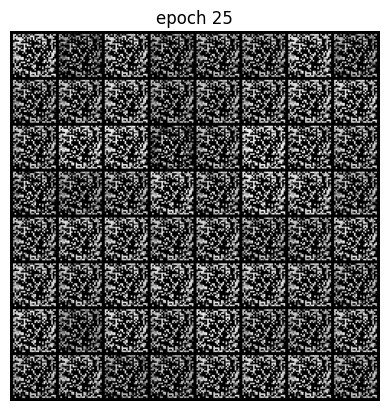

Epoch 25 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.30it/s]                         


Epoch 26 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.49it/s]                         


Epoch 27 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.75it/s]                         


Epoch 28 of 100
Generator loss: -0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.72it/s]                         


Epoch 29 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.71it/s]                         


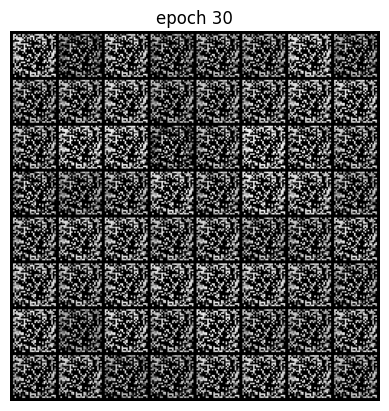

Epoch 30 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.46it/s]                         


Epoch 31 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.38it/s]                         


Epoch 32 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.59it/s]                         


Epoch 33 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.70it/s]                         


Epoch 34 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:17,  6.71it/s]                         


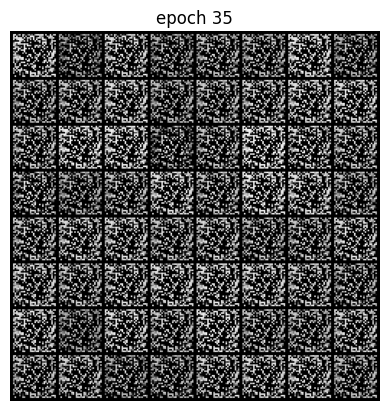

Epoch 35 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.24it/s]                         


Epoch 36 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.36it/s]                         


Epoch 37 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.55it/s]                         


Epoch 38 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.53it/s]                         


Epoch 39 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.51it/s]                         


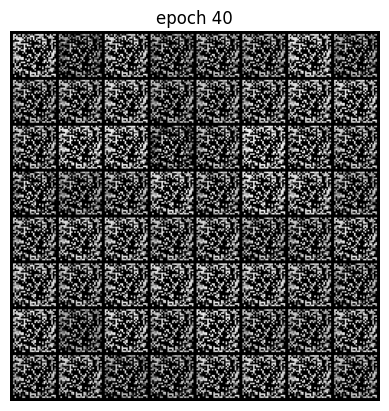

Epoch 40 of 100
Generator loss: -0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.15it/s]                         


Epoch 41 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.45it/s]                         


Epoch 42 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.52it/s]                         


Epoch 43 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.44it/s]                         


Epoch 44 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.37it/s]                         


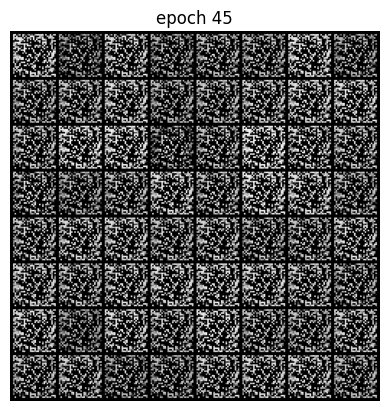

Epoch 45 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.21it/s]                         


Epoch 46 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.32it/s]                         


Epoch 47 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.45it/s]                         


Epoch 48 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.40it/s]                         


Epoch 49 of 100
Generator loss: -0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.17it/s]                         


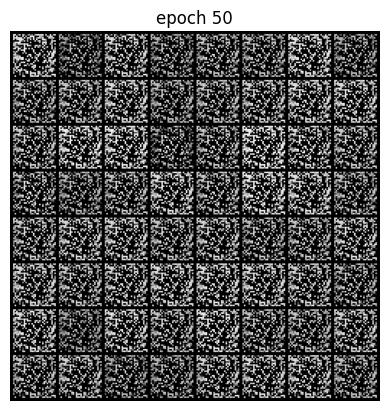

Epoch 50 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.12it/s]                         


Epoch 51 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.32it/s]                         


Epoch 52 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.37it/s]                         


Epoch 53 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.22it/s]                         


Epoch 54 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.07it/s]                         


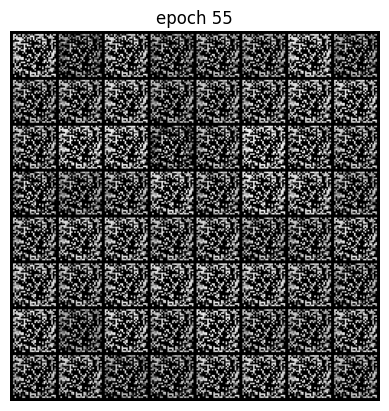

Epoch 55 of 100
Generator loss: -0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.23it/s]                         


Epoch 56 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.23it/s]                         


Epoch 57 of 100
Generator loss: -0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.35it/s]                         


Epoch 58 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.25it/s]                         


Epoch 59 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.10it/s]                         


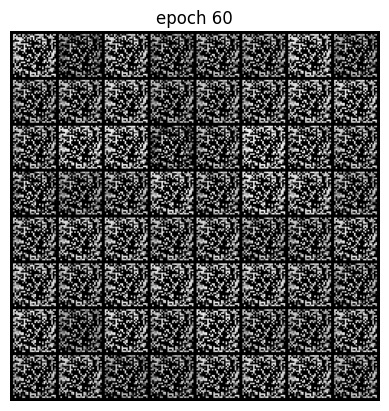

Epoch 60 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.22it/s]                         


Epoch 61 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.30it/s]                         


Epoch 62 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.28it/s]                         


Epoch 63 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.06it/s]                         


Epoch 64 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.04it/s]                         


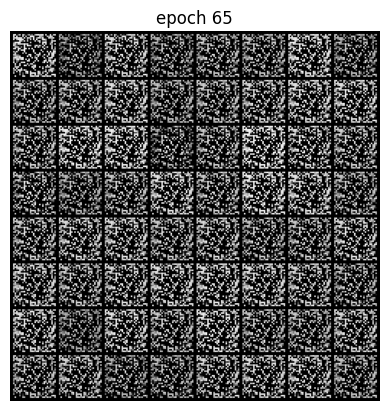

Epoch 65 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:18,  6.24it/s]                         


Epoch 66 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.16it/s]                         


Epoch 67 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.07it/s]                         


Epoch 68 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  5.95it/s]                         


Epoch 69 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  5.96it/s]                         


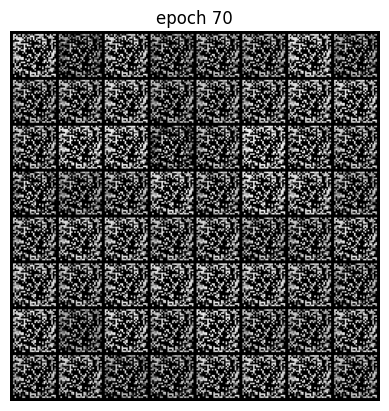

Epoch 70 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.04it/s]                         


Epoch 71 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.11it/s]                         


Epoch 72 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.00it/s]                         


Epoch 73 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.86it/s]                         


Epoch 74 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.07it/s]                         


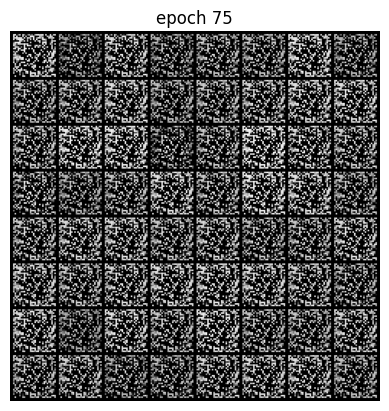

Epoch 75 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.05it/s]                         


Epoch 76 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.20it/s]                         


Epoch 77 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.03it/s]                         


Epoch 78 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.87it/s]                         


Epoch 79 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  5.90it/s]                         


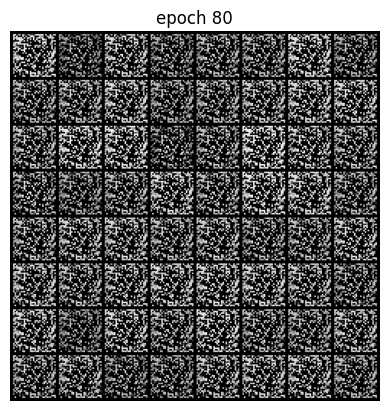

Epoch 80 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.10it/s]                         


Epoch 81 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.04it/s]                         


Epoch 82 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.03it/s]                         


Epoch 83 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.89it/s]                         


Epoch 84 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.77it/s]                         


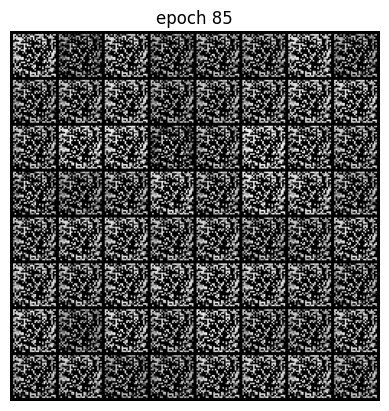

Epoch 85 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  5.92it/s]                         


Epoch 86 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  6.03it/s]                         


Epoch 87 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  5.93it/s]                         


Epoch 88 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:19,  5.92it/s]                         


Epoch 89 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.79it/s]                         


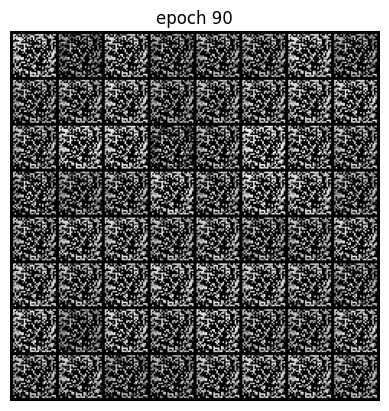

Epoch 90 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.80it/s]                         


Epoch 91 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.75it/s]                         


Epoch 92 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.84it/s]                         


Epoch 93 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.88it/s]                         


Epoch 94 of 100
Generator loss: -0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.80it/s]                         


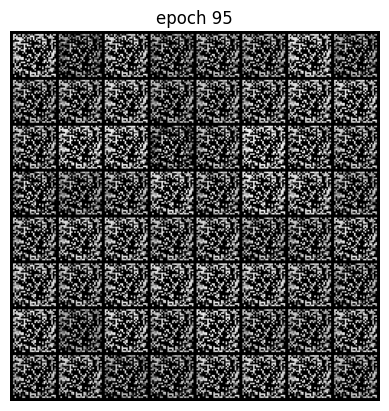

Epoch 95 of 100
Generator loss: -0.00000000, Discriminator loss: 0.00000000


118it [00:21,  5.51it/s]                         


Epoch 96 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.73it/s]                         


Epoch 97 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.78it/s]                         


Epoch 98 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.79it/s]                         


Epoch 99 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:20,  5.82it/s]                         


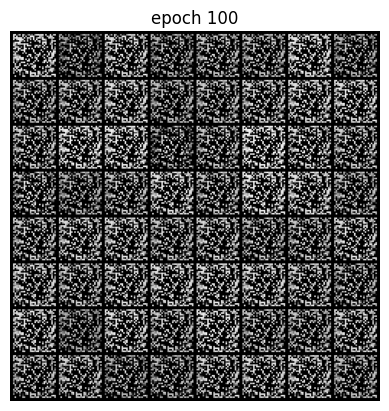

Epoch 100 of 100
Generator loss: 0.00000000, Discriminator loss: 0.00000000


In [14]:
from torch.nn.modules.distance import PairwiseDistance
torch.manual_seed(7777)

def generator_loss(output, true_label):
  #BCE so that the update rule in the slide that prevents gradient vanishing aligns with original;
  #discriminating between 0 and 1 (fake and real)
  return criterion(output,true_label)

def discriminator_loss(output, true_label):
  return criterion(output,true_label)


for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ##########
        # Update discriminators
        discriminator.zero_grad()
        #clear out previous grad
        real_cpu = data[0].to(device)
        tr_noise = create_noise(len(real_cpu), nz)

        #GIVEN the generator
        generated = generator(tr_noise)
        real_output = discriminator(real_cpu)
        label = label_real(len(real_cpu))
        errD_real = discriminator_loss(real_output, 1-label)
        errD_real.backward()

        #train w fake

        #Gradient ascent? improving discriminator with a generator fixed
        gen_output = discriminator(generated) #outputs prob [0,1] given generated images
        errD_fake = generator_loss(gen_output,1-label_fake(len(generated)))
        errD_fake.backward() #compute gradients
        errD = errD_real + errD_fake
        optim_d.step() #update model params based on the gradient

        loss_d += errD.item()

        #Gradient descent: improving generator with discriminator fixed
        generator.zero_grad()
        tr_noise2 = create_noise(len(real_cpu), nz)
        fake2 = generator(tr_noise2)
        gen_output2 = discriminator(fake2)
        label2 = label_real(len(real_cpu))
        errG = -criterion(1-gen_output2,1-label2) #update rule in the slide to prevent vanishing gradient
        errG.backward()
        optim_g.step()

        loss_g += errG.item()
        ######################################


    # create the final fake image for the epoch
    generated_img = generator(noise).cpu().detach()

    # make the images as grid
    generated_img = make_grid(generated_img)

    # visualize generated images
    if epoch==0 or (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()

    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)

    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")

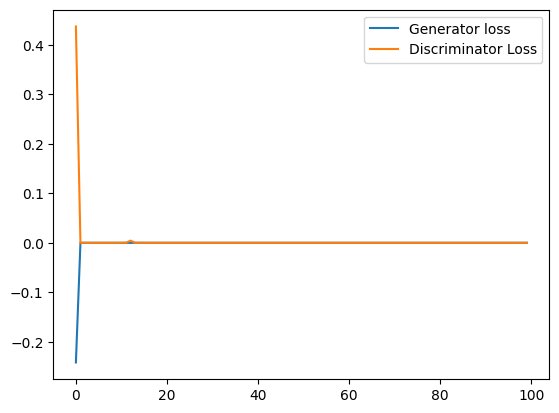

In [15]:
# Create a tensor and a matrix
tensor = np.random.rand(512, 1)  # Example 512x1 tensor
matrix = np.random.rand(128, 256)  # Example 128x256 matrix

# Reshape the tensor to match the size for multiplication
reshaped_tensor = tensor.reshape(4, 128)

# Perform matrix multiplication
result = np.dot(reshaped_tensor, matrix)

# save the generated images as GIF file
torch.save(generator.state_dict(), 'outputs/generator.pth')
imgs = [np.array(to_pil_image(img)) for img in images]
imageio.mimsave('outputs/generator_images.gif', imgs)
# plot and save the generator and discriminator loss
plt.figure()
plt.plot(losses_g, label='Generator loss')
plt.plot(losses_d, label='Discriminator Loss')
plt.legend()
plt.savefig('outputs/loss.png')

# Q. Write training loop

118it [00:17,  6.69it/s]                         


Epoch 1 of 100
Generator loss: 1.32658219, Discriminator loss: 0.90078419


118it [00:14,  8.00it/s]                         


Epoch 2 of 100
Generator loss: 2.00499682, Discriminator loss: 1.17617295


118it [00:14,  7.95it/s]                         


Epoch 3 of 100
Generator loss: 6.19980348, Discriminator loss: 0.26794707


118it [00:15,  7.72it/s]                         


Epoch 4 of 100
Generator loss: 6.73128734, Discriminator loss: 0.25844593


118it [00:16,  7.35it/s]                         


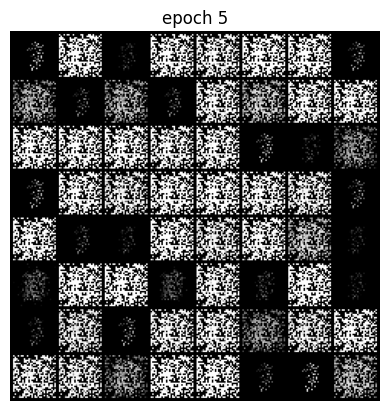

Epoch 5 of 100
Generator loss: 6.46233677, Discriminator loss: 0.46541318


118it [00:14,  7.89it/s]                         


Epoch 6 of 100
Generator loss: 6.82355870, Discriminator loss: 0.68850594


118it [00:15,  7.80it/s]                         


Epoch 7 of 100
Generator loss: 4.52353107, Discriminator loss: 0.69477325


118it [00:14,  8.01it/s]                         


Epoch 8 of 100
Generator loss: 3.46745894, Discriminator loss: 0.82128001


118it [00:14,  8.02it/s]                         


Epoch 9 of 100
Generator loss: 4.43224665, Discriminator loss: 0.70039035


118it [00:14,  7.93it/s]                         


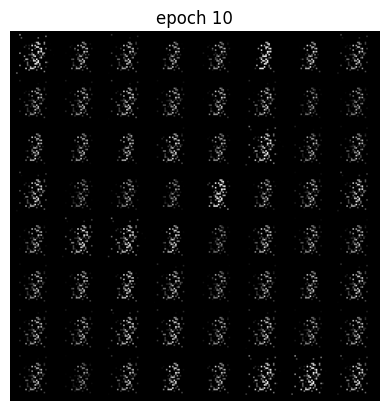

Epoch 10 of 100
Generator loss: 3.87179369, Discriminator loss: 0.78227791


118it [00:15,  7.81it/s]                         


Epoch 11 of 100
Generator loss: 3.43983763, Discriminator loss: 0.90921691


118it [00:15,  7.86it/s]                         


Epoch 12 of 100
Generator loss: 2.00721814, Discriminator loss: 1.13355389


118it [00:14,  7.91it/s]                         


Epoch 13 of 100
Generator loss: 2.31732918, Discriminator loss: 0.99821526


118it [00:15,  7.65it/s]                         


Epoch 14 of 100
Generator loss: 1.76706277, Discriminator loss: 1.00889358


118it [00:15,  7.71it/s]                         


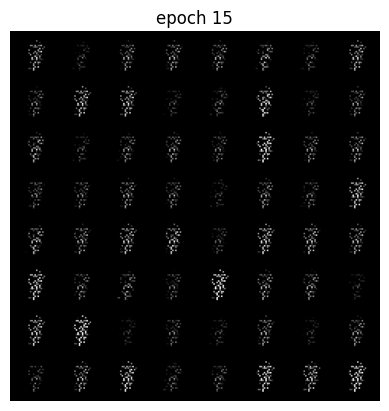

Epoch 15 of 100
Generator loss: 3.99274222, Discriminator loss: 0.59048236


118it [00:15,  7.86it/s]                         


Epoch 16 of 100
Generator loss: 2.20406904, Discriminator loss: 0.89312410


118it [00:15,  7.75it/s]                         


Epoch 17 of 100
Generator loss: 2.18530755, Discriminator loss: 0.89054705


118it [00:15,  7.83it/s]                         


Epoch 18 of 100
Generator loss: 2.28325959, Discriminator loss: 0.82631744


118it [00:15,  7.67it/s]                         


Epoch 19 of 100
Generator loss: 2.63531424, Discriminator loss: 0.59989385


118it [00:15,  7.79it/s]                         


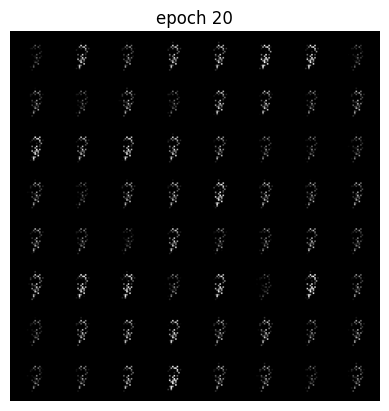

Epoch 20 of 100
Generator loss: 2.57614934, Discriminator loss: 0.59312104


118it [00:15,  7.86it/s]                         


Epoch 21 of 100
Generator loss: 2.38819978, Discriminator loss: 0.63657267


118it [00:15,  7.76it/s]                         


Epoch 22 of 100
Generator loss: 3.29421138, Discriminator loss: 0.53510387


118it [00:15,  7.68it/s]                         


Epoch 23 of 100
Generator loss: 2.69519125, Discriminator loss: 0.51731433


118it [00:15,  7.58it/s]                         


Epoch 24 of 100
Generator loss: 2.21512274, Discriminator loss: 0.55427871


118it [00:15,  7.44it/s]                         


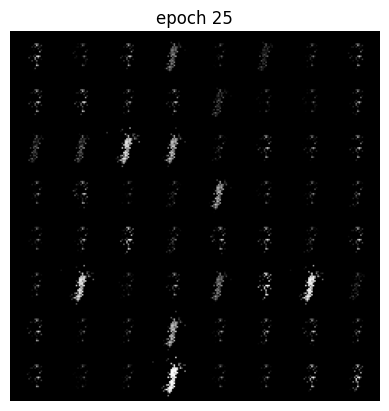

Epoch 25 of 100
Generator loss: 2.76168654, Discriminator loss: 0.50170655


118it [00:15,  7.86it/s]                         


Epoch 26 of 100
Generator loss: 2.48298247, Discriminator loss: 0.47068845


118it [00:14,  7.90it/s]                         


Epoch 27 of 100
Generator loss: 3.11749216, Discriminator loss: 0.39492118


118it [00:15,  7.84it/s]                         


Epoch 28 of 100
Generator loss: 3.05426194, Discriminator loss: 0.37618830


118it [00:15,  7.84it/s]                         


Epoch 29 of 100
Generator loss: 3.34165652, Discriminator loss: 0.39216811


118it [00:15,  7.80it/s]                         


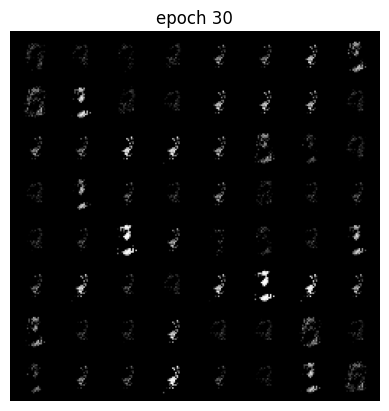

Epoch 30 of 100
Generator loss: 3.24447893, Discriminator loss: 0.40166895


118it [00:15,  7.81it/s]                         


Epoch 31 of 100
Generator loss: 2.87715831, Discriminator loss: 0.55336958


118it [00:15,  7.73it/s]                         


Epoch 32 of 100
Generator loss: 2.73599196, Discriminator loss: 0.49197500


118it [00:15,  7.73it/s]                         


Epoch 33 of 100
Generator loss: 2.88469914, Discriminator loss: 0.43309040


118it [00:15,  7.56it/s]                         


Epoch 34 of 100
Generator loss: 3.46948768, Discriminator loss: 0.33904190


118it [00:15,  7.75it/s]                         


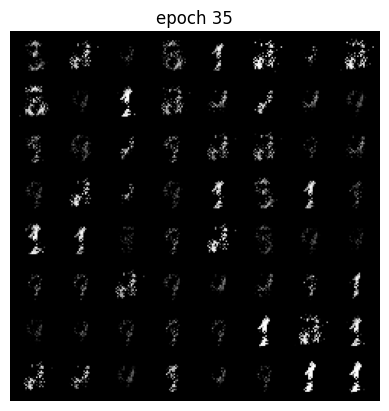

Epoch 35 of 100
Generator loss: 3.17227069, Discriminator loss: 0.44043642


118it [00:15,  7.72it/s]                         


Epoch 36 of 100
Generator loss: 3.53866641, Discriminator loss: 0.35567665


118it [00:15,  7.72it/s]                         


Epoch 37 of 100
Generator loss: 3.55758773, Discriminator loss: 0.43345846


118it [00:15,  7.67it/s]                         


Epoch 38 of 100
Generator loss: 2.88362734, Discriminator loss: 0.53734917


118it [00:15,  7.72it/s]                         


Epoch 39 of 100
Generator loss: 3.06593713, Discriminator loss: 0.42182004


118it [00:15,  7.82it/s]                         


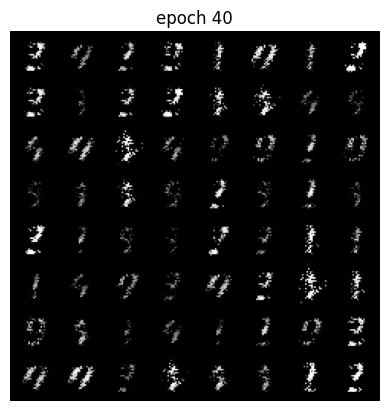

Epoch 40 of 100
Generator loss: 3.58561388, Discriminator loss: 0.37754949


118it [00:15,  7.59it/s]                         


Epoch 41 of 100
Generator loss: 3.16278671, Discriminator loss: 0.51838569


118it [00:15,  7.75it/s]                         


Epoch 42 of 100
Generator loss: 2.85406772, Discriminator loss: 0.47403014


118it [00:15,  7.60it/s]                         


Epoch 43 of 100
Generator loss: 3.28559676, Discriminator loss: 0.40680134


118it [00:15,  7.60it/s]                         


Epoch 44 of 100
Generator loss: 3.38074749, Discriminator loss: 0.43542454


118it [00:16,  7.37it/s]                         


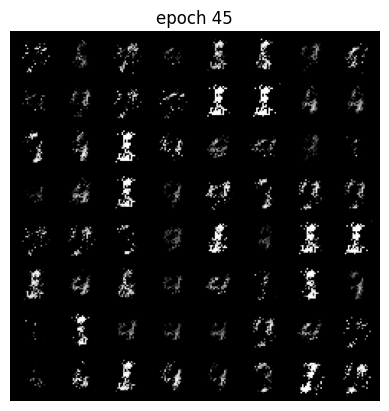

Epoch 45 of 100
Generator loss: 3.43029788, Discriminator loss: 0.41478818


118it [00:15,  7.64it/s]                         


Epoch 46 of 100
Generator loss: 3.42411589, Discriminator loss: 0.42154622


118it [00:15,  7.71it/s]                         


Epoch 47 of 100
Generator loss: 3.26089579, Discriminator loss: 0.42064353


118it [00:15,  7.83it/s]                         


Epoch 48 of 100
Generator loss: 3.25547659, Discriminator loss: 0.50839116


118it [00:15,  7.70it/s]                         


Epoch 49 of 100
Generator loss: 3.08486035, Discriminator loss: 0.49803825


118it [00:15,  7.80it/s]                         


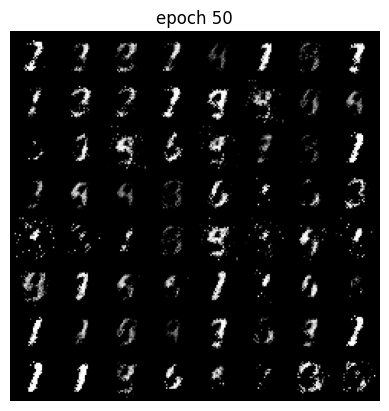

Epoch 50 of 100
Generator loss: 2.61478250, Discriminator loss: 0.54925845


118it [00:15,  7.63it/s]                         


Epoch 51 of 100
Generator loss: 3.15592568, Discriminator loss: 0.46957358


118it [00:15,  7.59it/s]                         


Epoch 52 of 100
Generator loss: 2.89124295, Discriminator loss: 0.53420300


118it [00:15,  7.55it/s]                         


Epoch 53 of 100
Generator loss: 2.87283931, Discriminator loss: 0.50727805


118it [00:15,  7.45it/s]                         


Epoch 54 of 100
Generator loss: 2.95392168, Discriminator loss: 0.51265158


118it [00:15,  7.51it/s]                         


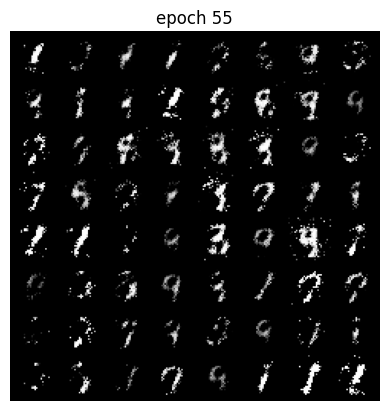

Epoch 55 of 100
Generator loss: 2.97701062, Discriminator loss: 0.49853668


118it [00:15,  7.76it/s]                         


Epoch 56 of 100
Generator loss: 2.97000193, Discriminator loss: 0.48734986


118it [00:15,  7.68it/s]                         


Epoch 57 of 100
Generator loss: 2.98521028, Discriminator loss: 0.49828388


118it [00:15,  7.73it/s]                         


Epoch 58 of 100
Generator loss: 3.16204942, Discriminator loss: 0.44116203


118it [00:15,  7.63it/s]                         


Epoch 59 of 100
Generator loss: 3.05286233, Discriminator loss: 0.50667743


118it [00:15,  7.71it/s]                         


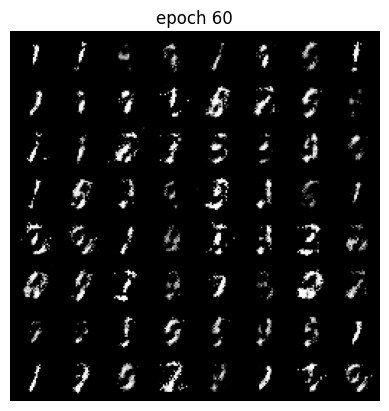

Epoch 60 of 100
Generator loss: 2.74409531, Discriminator loss: 0.61716843


118it [00:15,  7.68it/s]                         


Epoch 61 of 100
Generator loss: 3.05227648, Discriminator loss: 0.51898765


118it [00:15,  7.69it/s]                         


Epoch 62 of 100
Generator loss: 3.02714067, Discriminator loss: 0.47700891


118it [00:16,  7.31it/s]                         


Epoch 63 of 100
Generator loss: 3.00324542, Discriminator loss: 0.52331503


118it [00:15,  7.38it/s]                         


Epoch 64 of 100
Generator loss: 2.83744613, Discriminator loss: 0.54509197


118it [00:15,  7.53it/s]                         


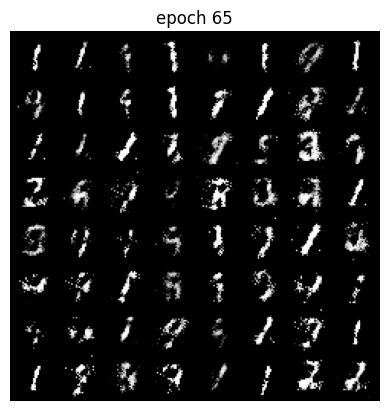

Epoch 65 of 100
Generator loss: 2.83664248, Discriminator loss: 0.59492699


118it [00:15,  7.53it/s]                         


Epoch 66 of 100
Generator loss: 2.61976887, Discriminator loss: 0.60754468


118it [00:15,  7.59it/s]                         


Epoch 67 of 100
Generator loss: 2.63913103, Discriminator loss: 0.57504536


118it [00:15,  7.61it/s]                         


Epoch 68 of 100
Generator loss: 2.73719433, Discriminator loss: 0.55707241


118it [00:15,  7.55it/s]                         


Epoch 69 of 100
Generator loss: 2.67555238, Discriminator loss: 0.58948476


118it [00:15,  7.70it/s]                         


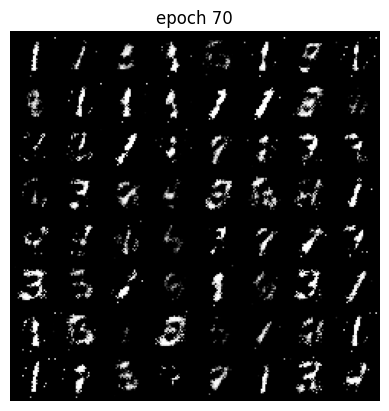

Epoch 70 of 100
Generator loss: 2.82000228, Discriminator loss: 0.58651376


118it [00:15,  7.59it/s]                         


Epoch 71 of 100
Generator loss: 2.70902724, Discriminator loss: 0.59118146


118it [00:15,  7.53it/s]                         


Epoch 72 of 100
Generator loss: 2.49740714, Discriminator loss: 0.60637638


118it [00:16,  7.34it/s]                         


Epoch 73 of 100
Generator loss: 2.37764470, Discriminator loss: 0.62599384


118it [00:15,  7.46it/s]                         


Epoch 74 of 100
Generator loss: 2.39112375, Discriminator loss: 0.60252616


118it [00:15,  7.61it/s]                         


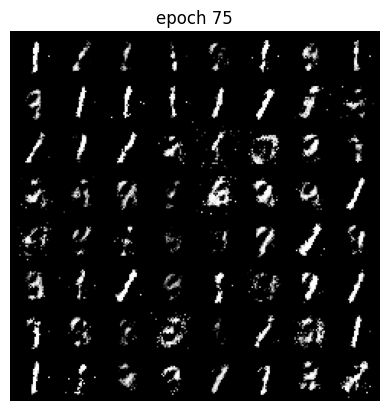

Epoch 75 of 100
Generator loss: 2.54366900, Discriminator loss: 0.61927942


118it [00:15,  7.66it/s]                         


Epoch 76 of 100
Generator loss: 2.28181297, Discriminator loss: 0.64937040


118it [00:15,  7.62it/s]                         


Epoch 77 of 100
Generator loss: 2.47818676, Discriminator loss: 0.63041371


118it [00:15,  7.65it/s]                         


Epoch 78 of 100
Generator loss: 2.34174711, Discriminator loss: 0.66728188


118it [00:15,  7.66it/s]                         


Epoch 79 of 100
Generator loss: 2.42543039, Discriminator loss: 0.63507391


118it [00:15,  7.51it/s]                         


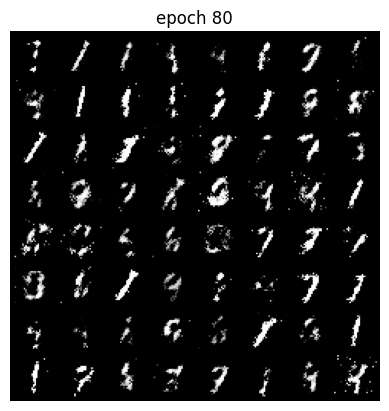

Epoch 80 of 100
Generator loss: 2.45935234, Discriminator loss: 0.63778159


118it [00:16,  7.30it/s]                         


Epoch 81 of 100
Generator loss: 2.48141382, Discriminator loss: 0.63857263


118it [00:15,  7.38it/s]                         


Epoch 82 of 100
Generator loss: 2.36206000, Discriminator loss: 0.63674690


118it [00:15,  7.64it/s]                         


Epoch 83 of 100
Generator loss: 2.50267186, Discriminator loss: 0.60299298


118it [00:15,  7.50it/s]                         


Epoch 84 of 100
Generator loss: 2.28860247, Discriminator loss: 0.66510385


118it [00:15,  7.41it/s]                         


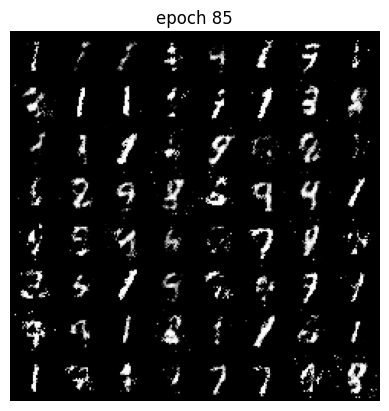

Epoch 85 of 100
Generator loss: 2.32185240, Discriminator loss: 0.67818637


118it [00:15,  7.60it/s]                         


Epoch 86 of 100
Generator loss: 2.42153785, Discriminator loss: 0.68203775


118it [00:15,  7.61it/s]                         


Epoch 87 of 100
Generator loss: 2.29285706, Discriminator loss: 0.68065612


118it [00:15,  7.64it/s]                         


Epoch 88 of 100
Generator loss: 2.20086971, Discriminator loss: 0.70460734


118it [00:15,  7.68it/s]                         


Epoch 89 of 100
Generator loss: 2.19092733, Discriminator loss: 0.73851276


118it [00:16,  7.35it/s]                         


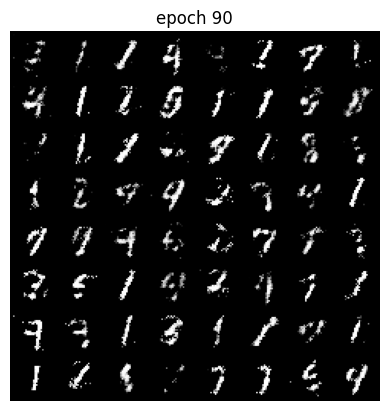

Epoch 90 of 100
Generator loss: 2.29591486, Discriminator loss: 0.68378670


118it [00:16,  7.32it/s]                         


Epoch 91 of 100
Generator loss: 2.13786332, Discriminator loss: 0.73604403


118it [00:15,  7.63it/s]                         


Epoch 92 of 100
Generator loss: 2.25418190, Discriminator loss: 0.70256564


118it [00:15,  7.59it/s]                         


Epoch 93 of 100
Generator loss: 2.21978241, Discriminator loss: 0.75097992


118it [00:15,  7.57it/s]                         


Epoch 94 of 100
Generator loss: 2.25166172, Discriminator loss: 0.66741655


118it [00:15,  7.44it/s]                         


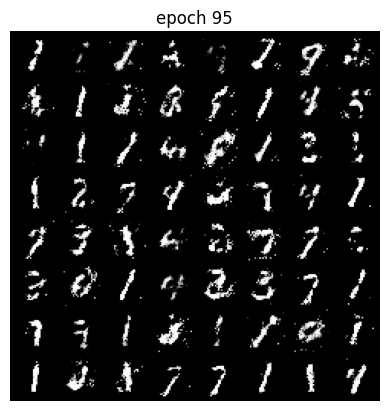

Epoch 95 of 100
Generator loss: 2.17329087, Discriminator loss: 0.72627305


118it [00:15,  7.44it/s]                         


Epoch 96 of 100
Generator loss: 2.21278638, Discriminator loss: 0.74715800


118it [00:15,  7.64it/s]                         


Epoch 97 of 100
Generator loss: 2.08589536, Discriminator loss: 0.76304096


118it [00:15,  7.54it/s]                         


Epoch 98 of 100
Generator loss: 2.11987170, Discriminator loss: 0.75461469


118it [00:15,  7.51it/s]                         


Epoch 99 of 100
Generator loss: 2.09533161, Discriminator loss: 0.75766128


118it [00:16,  7.33it/s]                         


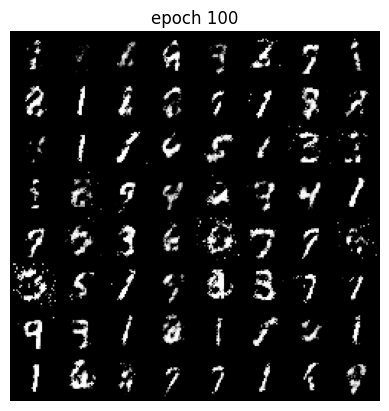

Epoch 100 of 100
Generator loss: 1.89095329, Discriminator loss: 0.78686788


In [ ]:
from torch.nn.modules.distance import PairwiseDistance
torch.manual_seed(7777)

def generator_loss(output, true_label):
  #BCE so that the update rule in the slide that prevents gradient vanishing aligns with original;
  #discriminating between 0 and 1 (fake and real)
  return criterion(output,true_label)

def discriminator_loss(output, true_label):
  return criterion(output,true_label)


for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ##########
        # Update discriminators
        discriminator.zero_grad()
        #clear out previous grad
        real_cpu = data[0].to(device)
        tr_noise = create_noise(len(real_cpu), nz)

        #GIVEN the generator
        generated = generator(tr_noise)
        real_output = discriminator(real_cpu)
        label = label_real(len(real_cpu))
        errD_real = discriminator_loss(real_output, label)
        errD_real.backward()

        #train w fake

        #Gradient ascent? improving discriminator with a generator fixed
        gen_output = discriminator(generated) #outputs prob [0,1] given generated images
        errD_fake = generator_loss(gen_output,label_fake(len(generated)))
        errD_fake.backward() #compute gradients
        errD = errD_real + errD_fake
        optim_d.step() #update model params based on the gradient

        loss_d += errD.item()

        #Gradient descent: improving generator with discriminator fixed
        generator.zero_grad()
        tr_noise2 = create_noise(len(real_cpu), nz)
        fake2 = generator(tr_noise2)
        gen_output2 = discriminator(fake2)
        label2 = label_real(len(real_cpu))
        errG = criterion(gen_output2,label2) #update rule in the slide to prevent vanishing gradient
        errG.backward()
        optim_g.step()

        loss_g += errG.item()
        ######################################


    # create the final fake image for the epoch
    generated_img = generator(noise).cpu().detach()

    # make the images as grid
    generated_img = make_grid(generated_img)

    # visualize generated images
    if epoch==0 or (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()

    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)

    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")

In [ ]:
# Create a tensor and a matrix
tensor = np.random.rand(512, 1)  # Example 512x1 tensor
matrix = np.random.rand(128, 256)  # Example 128x256 matrix

# Reshape the tensor to match the size for multiplication
reshaped_tensor = tensor.reshape(4, 128)

# Perform matrix multiplication
result = np.dot(reshaped_tensor, matrix)

In [ ]:
# save the generated images as GIF file
torch.save(generator.state_dict(), 'outputs/generator.pth')
imgs = [np.array(to_pil_image(img)) for img in images]
imageio.mimsave('outputs/generator_images.gif', imgs)
# plot and save the generator and discriminator loss
plt.figure()
plt.plot(losses_g, label='Generator loss')
plt.plot(losses_d, label='Discriminator Loss')
plt.legend()
plt.savefig('outputs/loss.png')

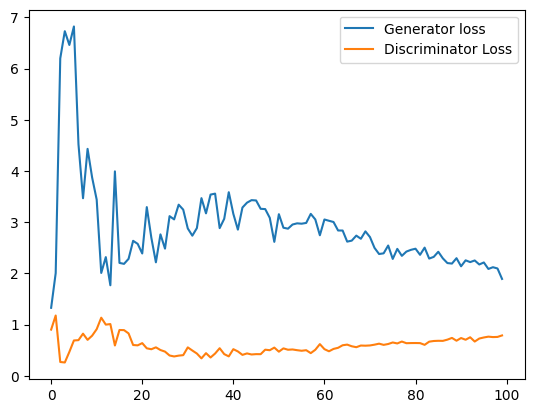

## Improving GAN training

In [ ]:
def weights_init_he(m):
    classname = m.__class__.__name__
    if classname.find('Linear') != -1:
        nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
        if m.bias is not None:
            nn.init.constant_(m.bias.data, 0)
    elif classname.find('Conv') != -1:
        nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
        if m.bias is not None:
            nn.init.constant_(m.bias.data, 0)

generator2 = Generator(nz).to(device)
discriminator2 = Discriminator().to(device)

generator2.apply(weights_init_he)
discriminator2.apply(weights_init_he)

Discriminator(
  (main): Sequential(
    (0): Linear(in_features=784, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=1024, out_features=512, bias=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Dropout(p=0.3, inplace=False)
    (6): Linear(in_features=512, out_features=256, bias=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Dropout(p=0.3, inplace=False)
    (9): Linear(in_features=256, out_features=1, bias=True)
    (10): Sigmoid()
  )
)

In [36]:
class Generator2(nn.Module):
    def __init__(self, nz):
        super(Generator2, self).__init__()
        self.nz = nz
        self.main = nn.Sequential(
            nn.Linear(self.nz, 256),
            nn.BatchNorm1d(256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 512),
            nn.BatchNorm1d(512),
            #nn.Conv2DTranspose(256,kernel_size=3,strides=2,padding="same"),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1024),
            nn.BatchNorm1d(1024),
            #nn.Conv2DTranspose(256,kernel_size=3,strides=2,padding="same"),
            nn.LeakyReLU(0.2),

            ####ADDITIONAL
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            #Output layer
            nn.ConvTranspose2d(128, 1, kernel_size=4, stride=2, padding=1),
            nn.Tanh()

            ####PREVIOUS
            # nn.Linear(1024, 784),
            # nn.Tanh(),
        )
    def forward(self, x):
        return self.main(x).view(-1, 1, 28, 28)

class Discriminator2(nn.Module):
    def __init__(self):
        super(Discriminator2, self).__init__()
        self.n_input = 784
        self.main = nn.Sequential(
            nn.Linear(self.n_input, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(256, 1),
            nn.Sigmoid(),
        )
    def forward(self, x):
        x = x.view(-1, 784)
        return self.main(x)

In [37]:
generator2 = Generator2(nz).to(device)
discriminator2 = Discriminator2().to(device)

optim_g2 = optim.Adam(generator2.parameters(), lr=0.00001)
optim_d2 = optim.Adam(discriminator2.parameters(), lr=0.00001)

In [27]:
tr_noise.shape,nz

(torch.Size([512, 128]), 128)

118it [00:16,  7.08it/s]                         


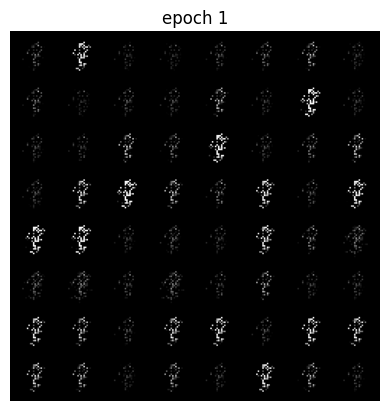

Epoch 1 of 100
Generator loss: 0.36144097, Discriminator loss: 0.71120614


118it [00:16,  7.19it/s]                         


Epoch 2 of 100
Generator loss: 0.32237924, Discriminator loss: 0.86710593


118it [00:16,  6.99it/s]                         


Epoch 3 of 100
Generator loss: 0.31868495, Discriminator loss: 0.91637745


118it [00:16,  7.19it/s]                         


Epoch 4 of 100
Generator loss: 0.29059845, Discriminator loss: 1.01800859


118it [00:16,  7.27it/s]                         


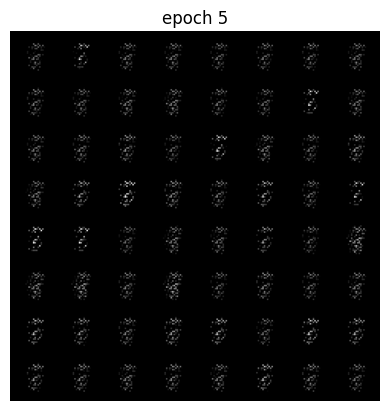

Epoch 5 of 100
Generator loss: 0.30520627, Discriminator loss: 0.94160809


118it [00:16,  7.14it/s]                         


Epoch 6 of 100
Generator loss: 0.33385359, Discriminator loss: 0.93860848


118it [00:16,  7.25it/s]                         


Epoch 7 of 100
Generator loss: 0.34711804, Discriminator loss: 0.73765297


118it [00:16,  7.23it/s]                         


Epoch 8 of 100
Generator loss: 0.38662500, Discriminator loss: 0.75840295


118it [00:17,  6.90it/s]                         


Epoch 9 of 100
Generator loss: 0.38093468, Discriminator loss: 0.56881969


118it [00:16,  7.13it/s]                         


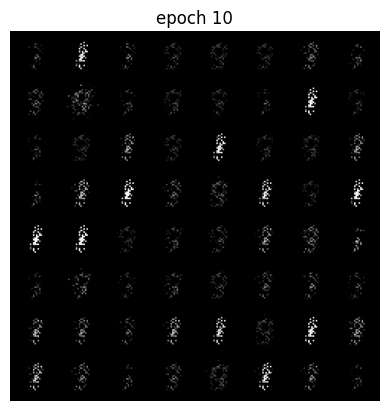

Epoch 10 of 100
Generator loss: 0.40757223, Discriminator loss: 0.53005947


118it [00:16,  7.15it/s]                         


Epoch 11 of 100
Generator loss: 0.39816551, Discriminator loss: 0.53757687


118it [00:16,  7.23it/s]                         


Epoch 12 of 100
Generator loss: 0.36875512, Discriminator loss: 0.67319466


118it [00:16,  7.31it/s]                         


Epoch 13 of 100
Generator loss: 0.40576093, Discriminator loss: 0.49221702


118it [00:16,  7.11it/s]                         


Epoch 14 of 100
Generator loss: 0.43738349, Discriminator loss: 0.35642575


118it [00:17,  6.75it/s]                         


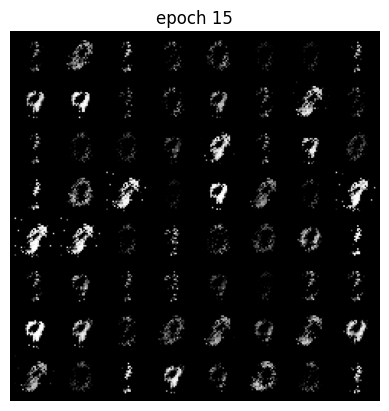

Epoch 15 of 100
Generator loss: 0.42286361, Discriminator loss: 0.42850374


118it [00:16,  6.96it/s]                         


Epoch 16 of 100
Generator loss: 0.40624807, Discriminator loss: 0.52130136


118it [00:16,  7.12it/s]                         


Epoch 17 of 100
Generator loss: 0.41739386, Discriminator loss: 0.43673156


118it [00:16,  7.09it/s]                         


Epoch 18 of 100
Generator loss: 0.44031360, Discriminator loss: 0.31838608


118it [00:16,  7.02it/s]                         


Epoch 19 of 100
Generator loss: 0.39931971, Discriminator loss: 0.54610864


118it [00:16,  6.95it/s]                         


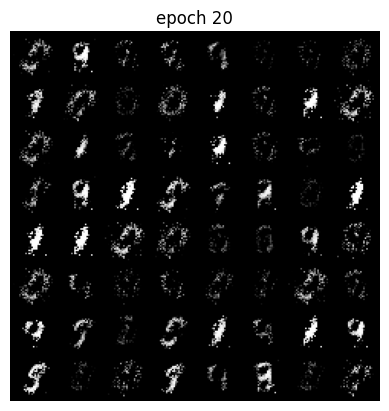

Epoch 20 of 100
Generator loss: 0.40418673, Discriminator loss: 0.53531580


118it [00:17,  6.90it/s]                         


Epoch 21 of 100
Generator loss: 0.40209299, Discriminator loss: 0.49754888


118it [00:16,  7.13it/s]                         


Epoch 22 of 100
Generator loss: 0.43778452, Discriminator loss: 0.31584008


118it [00:16,  7.12it/s]                         


Epoch 23 of 100
Generator loss: 0.44061979, Discriminator loss: 0.32317460


118it [00:16,  7.06it/s]                         


Epoch 24 of 100
Generator loss: 0.43123095, Discriminator loss: 0.41405416


118it [00:16,  7.11it/s]                         


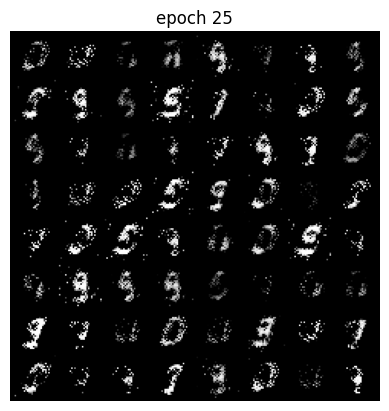

Epoch 25 of 100
Generator loss: 0.38581370, Discriminator loss: 0.67615921


118it [00:17,  6.82it/s]                         


Epoch 26 of 100
Generator loss: 0.37947046, Discriminator loss: 0.58909455


118it [00:17,  6.93it/s]                         


Epoch 27 of 100
Generator loss: 0.42346022, Discriminator loss: 0.38054681


118it [00:16,  7.06it/s]                         


Epoch 28 of 100
Generator loss: 0.41374067, Discriminator loss: 0.47269396


118it [00:16,  7.01it/s]                         


Epoch 29 of 100
Generator loss: 0.40764529, Discriminator loss: 0.48705324


118it [00:16,  7.02it/s]                         


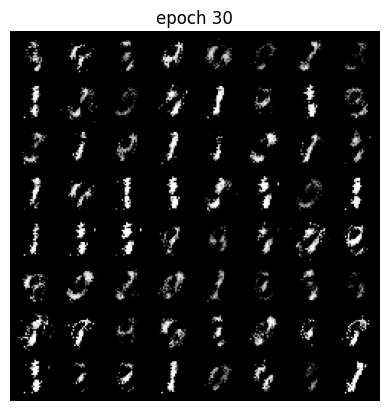

Epoch 30 of 100
Generator loss: 0.41265860, Discriminator loss: 0.46244204


118it [00:17,  6.92it/s]                         


Epoch 31 of 100
Generator loss: 0.38849652, Discriminator loss: 0.60177783


118it [00:17,  6.76it/s]                         


Epoch 32 of 100
Generator loss: 0.38197201, Discriminator loss: 0.61211525


118it [00:16,  7.09it/s]                         


Epoch 33 of 100
Generator loss: 0.37359054, Discriminator loss: 0.64496157


118it [00:16,  7.07it/s]                         


Epoch 34 of 100
Generator loss: 0.37174131, Discriminator loss: 0.66005603


118it [00:16,  7.04it/s]                         


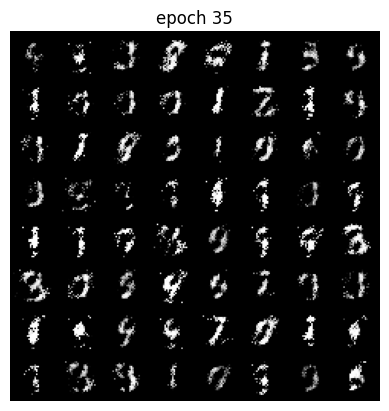

Epoch 35 of 100
Generator loss: 0.34774163, Discriminator loss: 0.73931278


118it [00:16,  7.01it/s]                         


Epoch 36 of 100
Generator loss: 0.37166630, Discriminator loss: 0.60842433


118it [00:17,  6.76it/s]                         


Epoch 37 of 100
Generator loss: 0.37438196, Discriminator loss: 0.62812813


118it [00:17,  6.87it/s]                         


Epoch 38 of 100
Generator loss: 0.37231758, Discriminator loss: 0.60091393


118it [00:16,  6.96it/s]                         


Epoch 39 of 100
Generator loss: 0.38006371, Discriminator loss: 0.60444341


118it [00:16,  6.97it/s]                         


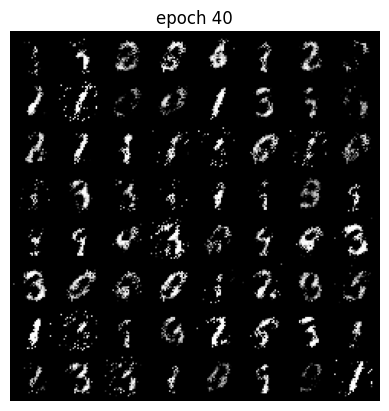

Epoch 40 of 100
Generator loss: 0.36798607, Discriminator loss: 0.64792910


118it [00:16,  7.02it/s]                         


Epoch 41 of 100
Generator loss: 0.36548171, Discriminator loss: 0.68379367


118it [00:17,  6.74it/s]                         


Epoch 42 of 100
Generator loss: 0.37260564, Discriminator loss: 0.61460056


118it [00:17,  6.78it/s]                         


Epoch 43 of 100
Generator loss: 0.38558100, Discriminator loss: 0.56594807


118it [00:16,  7.10it/s]                         


Epoch 44 of 100
Generator loss: 0.35952540, Discriminator loss: 0.71613297


118it [00:16,  7.08it/s]                         


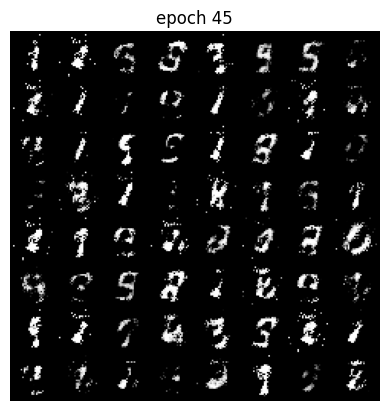

Epoch 45 of 100
Generator loss: 0.35294002, Discriminator loss: 0.69924339


118it [00:16,  6.97it/s]                         


Epoch 46 of 100
Generator loss: 0.37377281, Discriminator loss: 0.59709515


118it [00:17,  6.93it/s]                         


Epoch 47 of 100
Generator loss: 0.35557450, Discriminator loss: 0.72729478


118it [00:17,  6.81it/s]                         


Epoch 48 of 100
Generator loss: 0.36069494, Discriminator loss: 0.67015551


118it [00:16,  7.00it/s]                         


Epoch 49 of 100
Generator loss: 0.36344626, Discriminator loss: 0.65461796


118it [00:16,  6.99it/s]                         


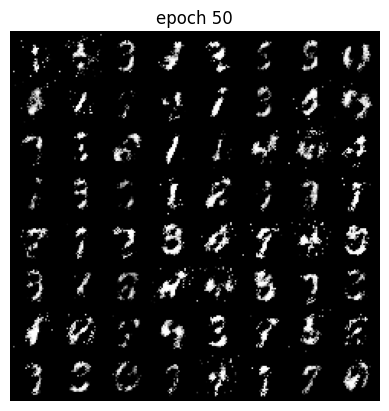

Epoch 50 of 100
Generator loss: 0.37271831, Discriminator loss: 0.62388360


118it [00:16,  7.01it/s]                         


Epoch 51 of 100
Generator loss: 0.34847255, Discriminator loss: 0.77225765


118it [00:16,  6.98it/s]                         


Epoch 52 of 100
Generator loss: 0.33947162, Discriminator loss: 0.74915446


118it [00:17,  6.83it/s]                         


Epoch 53 of 100
Generator loss: 0.34791281, Discriminator loss: 0.70932910


118it [00:17,  6.77it/s]                         


Epoch 54 of 100
Generator loss: 0.32183192, Discriminator loss: 0.82441172


118it [00:16,  7.16it/s]                         


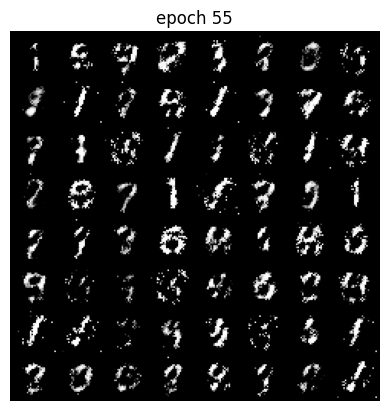

Epoch 55 of 100
Generator loss: 0.34599562, Discriminator loss: 0.72790505


118it [00:16,  7.14it/s]                         


Epoch 56 of 100
Generator loss: 0.35787900, Discriminator loss: 0.66097473


118it [00:16,  7.12it/s]                         


Epoch 57 of 100
Generator loss: 0.36482885, Discriminator loss: 0.65472101


118it [00:16,  7.19it/s]                         


Epoch 58 of 100
Generator loss: 0.34684997, Discriminator loss: 0.73203147


118it [00:16,  7.01it/s]                         


Epoch 59 of 100
Generator loss: 0.35553830, Discriminator loss: 0.69222870


118it [00:17,  6.89it/s]                         


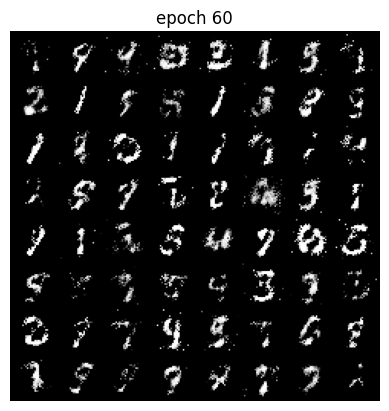

Epoch 60 of 100
Generator loss: 0.35462413, Discriminator loss: 0.67670939


118it [00:16,  7.15it/s]                         


Epoch 61 of 100
Generator loss: 0.33779906, Discriminator loss: 0.76148634


118it [00:16,  7.15it/s]                         


Epoch 62 of 100
Generator loss: 0.33817811, Discriminator loss: 0.77106417


118it [00:16,  7.13it/s]                         


Epoch 63 of 100
Generator loss: 0.35468812, Discriminator loss: 0.69373819


118it [00:16,  7.02it/s]                         


Epoch 64 of 100
Generator loss: 0.33699718, Discriminator loss: 0.74873558


118it [00:17,  6.89it/s]                         


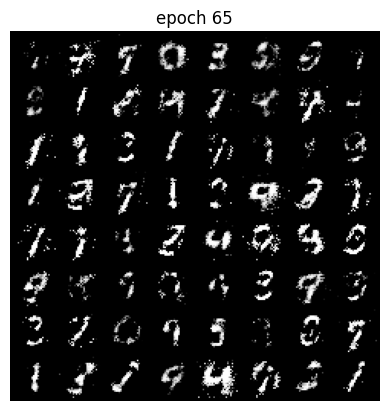

Epoch 65 of 100
Generator loss: 0.34667020, Discriminator loss: 0.72086800


118it [00:17,  6.72it/s]                         


Epoch 66 of 100
Generator loss: 0.32465079, Discriminator loss: 0.79165176


118it [00:16,  7.18it/s]                         


Epoch 67 of 100
Generator loss: 0.34641041, Discriminator loss: 0.72871330


118it [00:16,  7.10it/s]                         


Epoch 68 of 100
Generator loss: 0.33257633, Discriminator loss: 0.77061385


118it [00:16,  7.12it/s]                         


Epoch 69 of 100
Generator loss: 0.33319194, Discriminator loss: 0.76844419


118it [00:16,  6.97it/s]                         


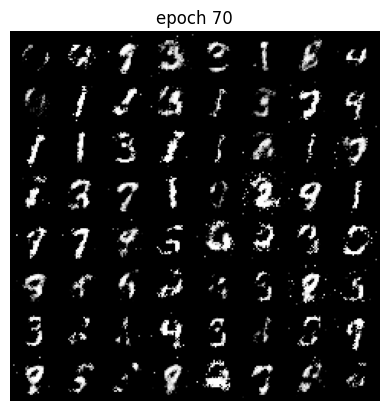

Epoch 70 of 100
Generator loss: 0.32095675, Discriminator loss: 0.81194921


118it [00:17,  6.70it/s]                         


Epoch 71 of 100
Generator loss: 0.29433433, Discriminator loss: 0.90872617


118it [00:17,  6.90it/s]                         


Epoch 72 of 100
Generator loss: 0.28479423, Discriminator loss: 0.94957944


118it [00:16,  7.11it/s]                         


Epoch 73 of 100
Generator loss: 0.31487275, Discriminator loss: 0.83149202


118it [00:16,  7.11it/s]                         


Epoch 74 of 100
Generator loss: 0.32471750, Discriminator loss: 0.79954979


118it [00:16,  7.09it/s]                         


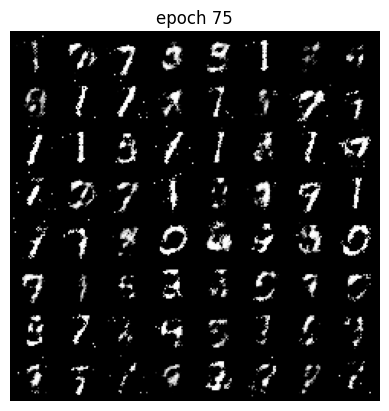

Epoch 75 of 100
Generator loss: 0.32717539, Discriminator loss: 0.77492223


118it [00:16,  7.02it/s]                         


Epoch 76 of 100
Generator loss: 0.31954929, Discriminator loss: 0.80784088


118it [00:17,  6.68it/s]                         


Epoch 77 of 100
Generator loss: 0.31161443, Discriminator loss: 0.85265894


118it [00:17,  6.84it/s]                         


Epoch 78 of 100
Generator loss: 0.31100545, Discriminator loss: 0.84863605


118it [00:16,  7.08it/s]                         


Epoch 79 of 100
Generator loss: 0.30363297, Discriminator loss: 0.86595289


118it [00:16,  7.09it/s]                         


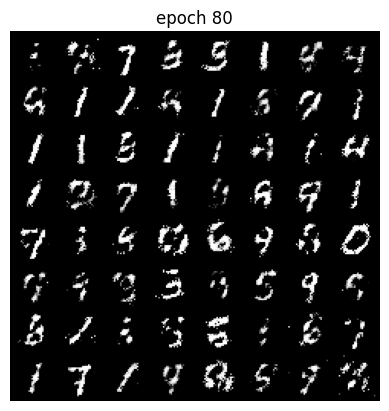

Epoch 80 of 100
Generator loss: 0.30099466, Discriminator loss: 0.87776883


118it [00:16,  7.02it/s]                         


Epoch 81 of 100
Generator loss: 0.30387367, Discriminator loss: 0.87800282


118it [00:16,  7.02it/s]                         


Epoch 82 of 100
Generator loss: 0.28833324, Discriminator loss: 0.91184369


118it [00:17,  6.83it/s]                         


Epoch 83 of 100
Generator loss: 0.28913851, Discriminator loss: 0.90673896


118it [00:17,  6.86it/s]                         


Epoch 84 of 100
Generator loss: 0.29861320, Discriminator loss: 0.89207136


118it [00:16,  7.00it/s]                         


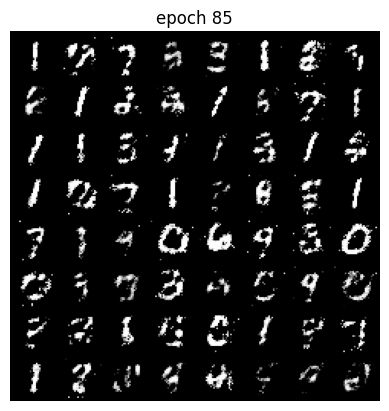

Epoch 85 of 100
Generator loss: 0.30673778, Discriminator loss: 0.86417094


118it [00:16,  7.08it/s]                         


Epoch 86 of 100
Generator loss: 0.28394108, Discriminator loss: 0.93788264


118it [00:16,  6.95it/s]                         


Epoch 87 of 100
Generator loss: 0.29133508, Discriminator loss: 0.90915559


118it [00:17,  6.91it/s]                         


Epoch 88 of 100
Generator loss: 0.28880494, Discriminator loss: 0.90654775


118it [00:18,  6.55it/s]                         


Epoch 89 of 100
Generator loss: 0.29202774, Discriminator loss: 0.90911613


118it [00:16,  7.04it/s]                         


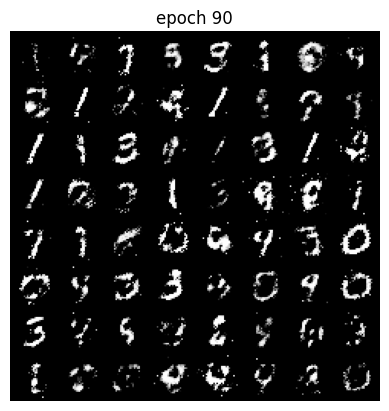

Epoch 90 of 100
Generator loss: 0.29441928, Discriminator loss: 0.89694341


118it [00:16,  7.00it/s]                         


Epoch 91 of 100
Generator loss: 0.30112971, Discriminator loss: 0.88196131


118it [00:24,  4.86it/s]                         


Epoch 92 of 100
Generator loss: 0.29060700, Discriminator loss: 0.90418463


118it [00:16,  7.02it/s]                         


Epoch 93 of 100
Generator loss: 0.29326611, Discriminator loss: 0.88508732


118it [00:16,  7.02it/s]                         


Epoch 94 of 100
Generator loss: 0.29137543, Discriminator loss: 0.91328738


118it [00:16,  7.07it/s]                         


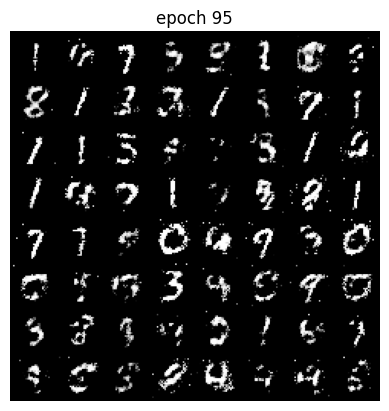

Epoch 95 of 100
Generator loss: 0.28059608, Discriminator loss: 0.95535085


118it [00:16,  7.03it/s]                         


Epoch 96 of 100
Generator loss: 0.28317222, Discriminator loss: 0.94072887


118it [00:17,  6.63it/s]                         


Epoch 97 of 100
Generator loss: 0.28600724, Discriminator loss: 0.93370894


118it [00:18,  6.27it/s]                         


Epoch 98 of 100
Generator loss: 0.27959467, Discriminator loss: 0.95596448


118it [00:17,  6.72it/s]                         


Epoch 99 of 100
Generator loss: 0.28045618, Discriminator loss: 0.93424703


118it [00:17,  6.65it/s]                         


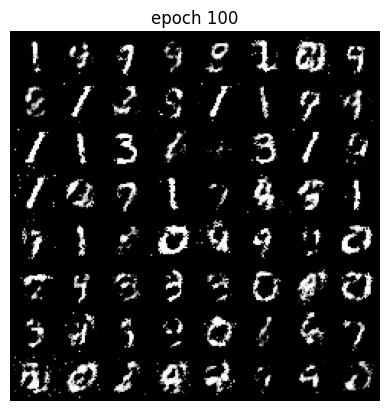

Epoch 100 of 100
Generator loss: 0.27869263, Discriminator loss: 0.95532922


In [9]:
from torch.nn.modules.distance import PairwiseDistance
torch.manual_seed(7777)

def label_real2(size):
    data = torch.ones(size, 1)*0.999
    return data.to(device)

# to create fake labels (0s)
def label_fake2(size):
    data = torch.ones(size, 1)*0.001
    return data.to(device)

def generator_loss(output, true_label):
  #BCE so that the update rule in the slide that prevents gradient vanishing aligns with original;
  #discriminating between 0 and 1 (fake and real)
  return criterion(output,true_label)

def discriminator_loss(output, true_label):
  return criterion(output,true_label)


for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ##########
        # Update discriminators
        discriminator.zero_grad()
        #clear out previous grad
        real_cpu = data[0].to(device)
        tr_noise = create_noise(len(real_cpu), nz)

        #GIVEN the generator
        generated = generator(tr_noise)
        real_output = discriminator(real_cpu)
        label = label_real2(len(real_cpu))
        errD_real = discriminator_loss(real_output, label)
        errD_real.backward()

        #train w fake

        #Gradient ascent? improving discriminator with a generator fixed
        gen_output = discriminator(generated) #outputs prob [0,1] given generated images
        errD_fake = generator_loss(gen_output,label_fake2(len(generated)))
        errD_fake.backward() #compute gradients
        errD = errD_real + errD_fake
        optim_d.step() #update zmodel params based on the gradient

        loss_d += errD.item()

        #Gradient descent: improving generator with discriminator fixed
        generator.zero_grad()
        tr_noise2 = create_noise(len(real_cpu), nz)
        fake2 = generator(tr_noise2)
        gen_output2 = discriminator(fake2)
        label2 = label_real2(len(real_cpu))
        #errG = criterion(gen_output2,label2) #update rule in the slide to prevent vanishing gradient
        #changing in loss fct
        errG = 0.5*torch.mean((gen_output2-label2)**2) #MSE
        errG.backward()
        optim_g.step()

        loss_g += errG.item()
        ######################################


    # create the final fake image for the epoch
    generated_img = generator(noise).cpu().detach()

    # make the images as grid
    generated_img = make_grid(generated_img)

    # visualize generated images
    if epoch==0 or (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()

    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)

    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")

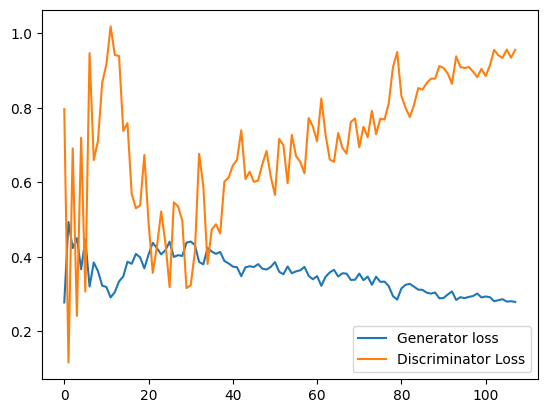

In [10]:
# Create a tensor and a matrix
tensor = np.random.rand(512, 1)  # Example 512x1 tensor
matrix = np.random.rand(128, 256)  # Example 128x256 matrix

# Reshape the tensor to match the size for multiplication
reshaped_tensor = tensor.reshape(4, 128)

# Perform matrix multiplication
result = np.dot(reshaped_tensor, matrix)

# save the generated images as GIF file
torch.save(generator.state_dict(), 'outputs/generator.pth')
imgs = [np.array(to_pil_image(img)) for img in images]
imageio.mimsave('outputs/generator_images.gif', imgs)
# plot and save the generator and discriminator loss
plt.figure()
plt.plot(losses_g, label='Generator loss')
plt.plot(losses_d, label='Discriminator Loss')
plt.legend()
plt.savefig('outputs/loss.png')

118it [00:18,  6.28it/s]                         


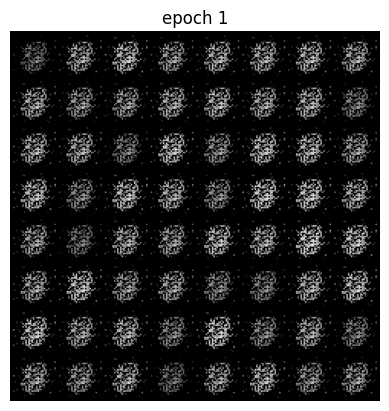

Epoch 1 of 100
Generator loss: 0.27611233, Discriminator loss: 0.71348895


118it [00:15,  7.43it/s]                         


Epoch 2 of 100
Generator loss: 0.49523711, Discriminator loss: 0.06657656


118it [00:15,  7.51it/s]                         


Epoch 3 of 100
Generator loss: 0.49756999, Discriminator loss: 0.04621652


118it [00:16,  7.28it/s]                         


Epoch 4 of 100
Generator loss: 0.44214772, Discriminator loss: 0.53441833


118it [00:16,  7.28it/s]                         


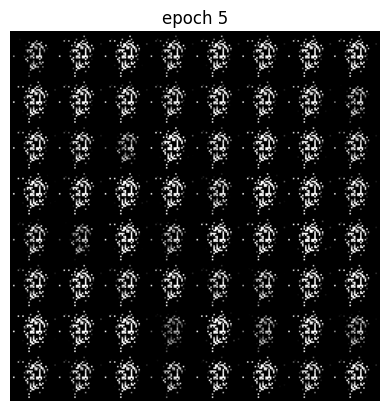

Epoch 5 of 100
Generator loss: 0.44651959, Discriminator loss: 0.26081243


118it [00:15,  7.52it/s]                         


Epoch 6 of 100
Generator loss: 0.50423500, Discriminator loss: 0.00016368


118it [00:16,  7.30it/s]                         


Epoch 7 of 100
Generator loss: 0.50421048, Discriminator loss: 0.00016503


118it [00:16,  7.21it/s]                         


Epoch 8 of 100
Generator loss: 0.50422114, Discriminator loss: 0.00032756


118it [00:15,  7.47it/s]                         


Epoch 9 of 100
Generator loss: 0.50416817, Discriminator loss: 0.00039417


118it [00:15,  7.61it/s]                         


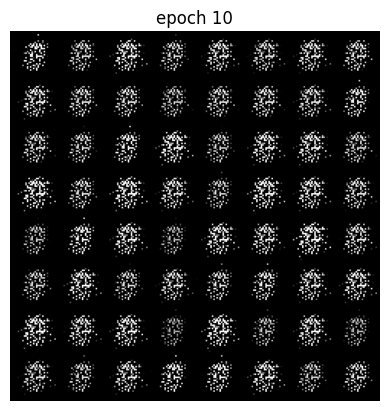

Epoch 10 of 100
Generator loss: 0.44856710, Discriminator loss: 0.33215821


118it [00:15,  7.49it/s]                         


Epoch 11 of 100
Generator loss: 0.50377053, Discriminator loss: 0.00146380


118it [00:15,  7.51it/s]                         


Epoch 12 of 100
Generator loss: 0.42633018, Discriminator loss: 0.58287964


118it [00:16,  7.09it/s]                         


Epoch 13 of 100
Generator loss: 0.50361608, Discriminator loss: 0.00277627


118it [00:16,  7.11it/s]                         


Epoch 14 of 100
Generator loss: 0.47330364, Discriminator loss: 0.23970114


118it [00:16,  7.32it/s]                         


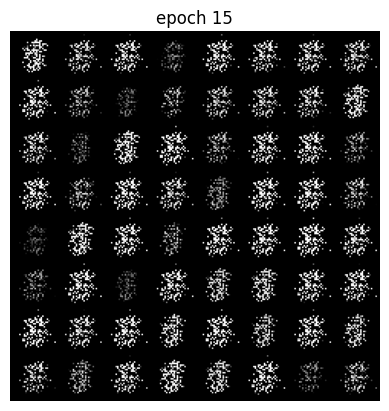

Epoch 15 of 100
Generator loss: 0.46940722, Discriminator loss: 0.30935079


118it [00:15,  7.58it/s]                         


Epoch 16 of 100
Generator loss: 0.50378357, Discriminator loss: 0.00163190


118it [00:15,  7.47it/s]                         


Epoch 17 of 100
Generator loss: 0.44758906, Discriminator loss: 0.35809558


118it [00:15,  7.54it/s]                         


Epoch 18 of 100
Generator loss: 0.39962332, Discriminator loss: 0.54928776


118it [00:15,  7.48it/s]                         


Epoch 19 of 100
Generator loss: 0.33841068, Discriminator loss: 0.97235257


118it [00:15,  7.48it/s]                         


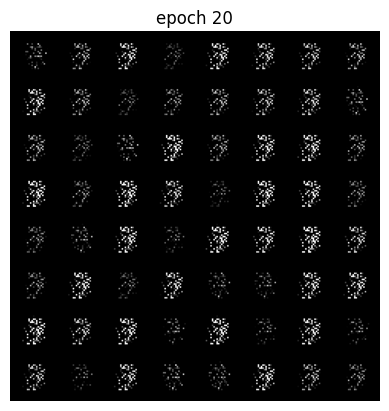

Epoch 20 of 100
Generator loss: 0.33939949, Discriminator loss: 0.85720934


118it [00:16,  7.14it/s]                         


Epoch 21 of 100
Generator loss: 0.33086186, Discriminator loss: 0.88709461


118it [00:16,  7.27it/s]                         


Epoch 22 of 100
Generator loss: 0.30869205, Discriminator loss: 0.96771575


118it [00:15,  7.53it/s]                         


Epoch 23 of 100
Generator loss: 0.34005544, Discriminator loss: 0.96143293


118it [00:15,  7.54it/s]                         


Epoch 24 of 100
Generator loss: 0.40763937, Discriminator loss: 0.55585339


118it [00:15,  7.52it/s]                         


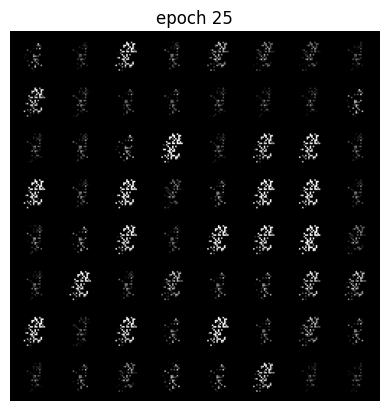

Epoch 25 of 100
Generator loss: 0.24719474, Discriminator loss: 1.22413535


118it [00:15,  7.48it/s]                         


Epoch 26 of 100
Generator loss: 0.18935497, Discriminator loss: 1.32746214


118it [00:15,  7.41it/s]                         


Epoch 27 of 100
Generator loss: 0.26449026, Discriminator loss: 1.13475344


118it [00:16,  7.16it/s]                         


Epoch 28 of 100
Generator loss: 0.25251477, Discriminator loss: 1.08424711


118it [00:16,  7.11it/s]                         


Epoch 29 of 100
Generator loss: 0.25159210, Discriminator loss: 1.09487161


118it [00:16,  7.12it/s]                         


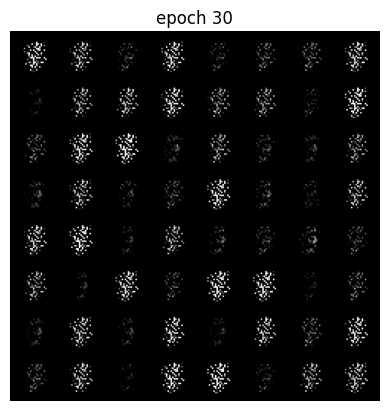

Epoch 30 of 100
Generator loss: 0.25884882, Discriminator loss: 1.12157133


118it [00:15,  7.42it/s]                         


Epoch 31 of 100
Generator loss: 0.29826922, Discriminator loss: 0.88041475


118it [00:15,  7.41it/s]                         


Epoch 32 of 100
Generator loss: 0.29114651, Discriminator loss: 0.94317708


118it [00:15,  7.48it/s]                         


Epoch 33 of 100
Generator loss: 0.32352623, Discriminator loss: 0.87673916


118it [00:15,  7.46it/s]                         


Epoch 34 of 100
Generator loss: 0.26169325, Discriminator loss: 1.11490388


118it [00:15,  7.38it/s]                         


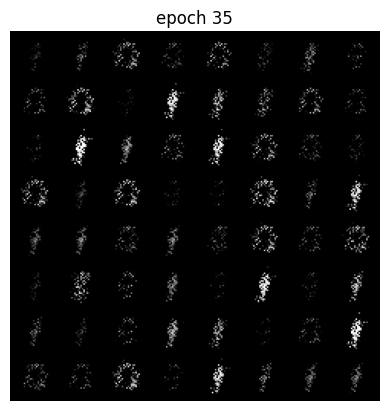

Epoch 35 of 100
Generator loss: 0.31128818, Discriminator loss: 0.85129892


118it [00:16,  7.33it/s]                         


Epoch 36 of 100
Generator loss: 0.26955543, Discriminator loss: 0.96191654


118it [00:16,  7.00it/s]                         


Epoch 37 of 100
Generator loss: 0.35557774, Discriminator loss: 0.62330204


118it [00:15,  7.50it/s]                         


Epoch 38 of 100
Generator loss: 0.25660557, Discriminator loss: 1.03629748


118it [00:15,  7.40it/s]                         


Epoch 39 of 100
Generator loss: 0.22325847, Discriminator loss: 1.28423276


118it [00:15,  7.49it/s]                         


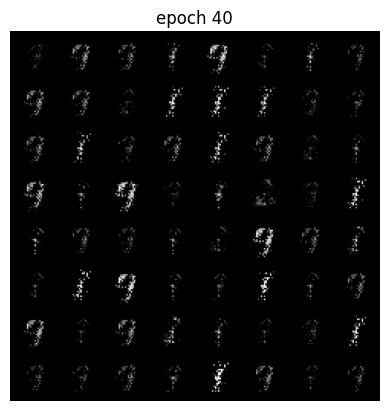

Epoch 40 of 100
Generator loss: 0.32641469, Discriminator loss: 0.80019684


118it [00:16,  7.34it/s]                         


Epoch 41 of 100
Generator loss: 0.35727685, Discriminator loss: 0.66338237


118it [00:16,  7.31it/s]                         


Epoch 42 of 100
Generator loss: 0.36619100, Discriminator loss: 0.66320216


118it [00:16,  7.16it/s]                         


Epoch 43 of 100
Generator loss: 0.29237820, Discriminator loss: 0.92509122


118it [00:16,  7.21it/s]                         


Epoch 44 of 100
Generator loss: 0.34473220, Discriminator loss: 0.67720159


118it [00:17,  6.79it/s]                         


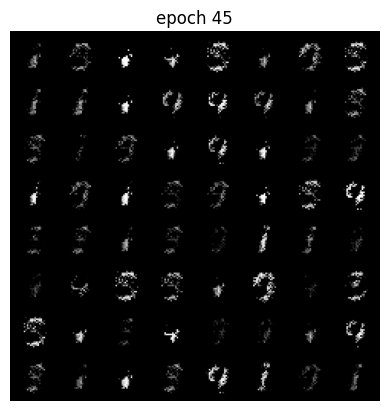

Epoch 45 of 100
Generator loss: 0.35389869, Discriminator loss: 0.70446356


118it [00:16,  7.33it/s]                         


Epoch 46 of 100
Generator loss: 0.35573264, Discriminator loss: 0.71016434


118it [00:16,  7.27it/s]                         


Epoch 47 of 100
Generator loss: 0.36842504, Discriminator loss: 0.56937325


118it [00:16,  7.34it/s]                         


Epoch 48 of 100
Generator loss: 0.41296903, Discriminator loss: 0.42595224


118it [00:16,  7.36it/s]                         


Epoch 49 of 100
Generator loss: 0.39167812, Discriminator loss: 0.54496420


118it [00:16,  7.21it/s]                         


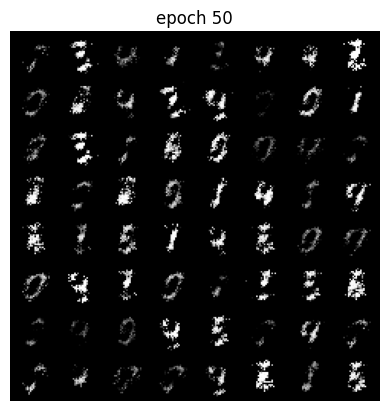

Epoch 50 of 100
Generator loss: 0.37900859, Discriminator loss: 0.65359120


118it [00:16,  7.21it/s]                         


Epoch 51 of 100
Generator loss: 0.34372364, Discriminator loss: 0.80369831


118it [00:16,  7.21it/s]                         


Epoch 52 of 100
Generator loss: 0.31334624, Discriminator loss: 0.87260673


118it [00:16,  7.29it/s]                         


Epoch 53 of 100
Generator loss: 0.37705120, Discriminator loss: 0.64277444


118it [00:16,  7.34it/s]                         


Epoch 54 of 100
Generator loss: 0.38708617, Discriminator loss: 0.53363377


118it [00:15,  7.41it/s]                         


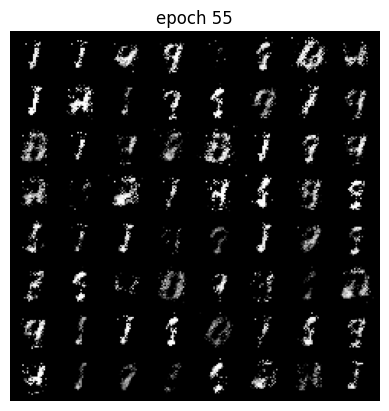

Epoch 55 of 100
Generator loss: 0.37160585, Discriminator loss: 0.60541326


118it [00:16,  7.22it/s]                         


Epoch 56 of 100
Generator loss: 0.39682005, Discriminator loss: 0.53279285


118it [00:17,  6.88it/s]                         


Epoch 57 of 100
Generator loss: 0.37638843, Discriminator loss: 0.63178413


118it [00:16,  7.16it/s]                         


Epoch 58 of 100
Generator loss: 0.39549464, Discriminator loss: 0.52416628


118it [00:16,  7.31it/s]                         


Epoch 59 of 100
Generator loss: 0.37494956, Discriminator loss: 0.61086119


118it [00:16,  7.29it/s]                         


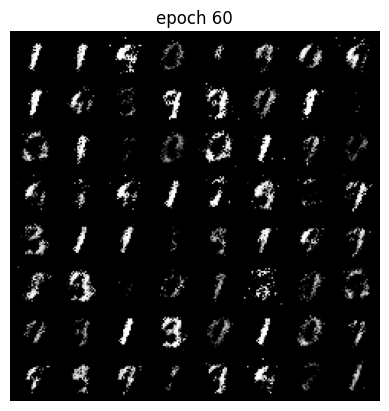

Epoch 60 of 100
Generator loss: 0.38085923, Discriminator loss: 0.61297336


118it [00:17,  6.83it/s]                         


Epoch 61 of 100
Generator loss: 0.37709428, Discriminator loss: 0.59778360


118it [00:16,  7.28it/s]                         


Epoch 62 of 100
Generator loss: 0.37032819, Discriminator loss: 0.68322117


118it [00:16,  7.15it/s]                         


Epoch 63 of 100
Generator loss: 0.35831618, Discriminator loss: 0.69154699


118it [00:16,  6.98it/s]                         


Epoch 64 of 100
Generator loss: 0.35587239, Discriminator loss: 0.68490769


118it [00:16,  7.08it/s]                         


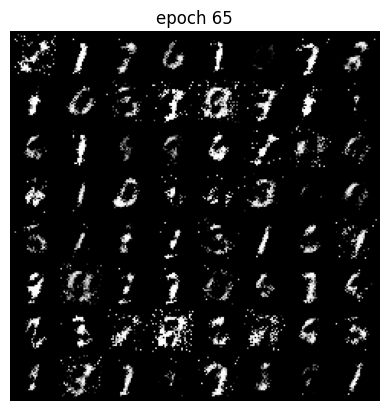

Epoch 65 of 100
Generator loss: 0.35409191, Discriminator loss: 0.70828932


118it [00:16,  7.23it/s]                         


Epoch 66 of 100
Generator loss: 0.36350839, Discriminator loss: 0.65201651


118it [00:16,  7.17it/s]                         


Epoch 67 of 100
Generator loss: 0.35612996, Discriminator loss: 0.68035203


118it [00:15,  7.41it/s]                         


Epoch 68 of 100
Generator loss: 0.37752426, Discriminator loss: 0.59197610


118it [00:16,  7.04it/s]                         


Epoch 69 of 100
Generator loss: 0.40112999, Discriminator loss: 0.48913999


118it [00:16,  7.27it/s]                         


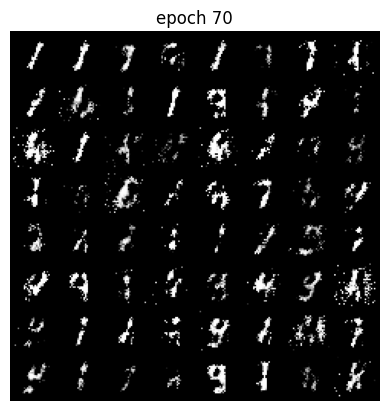

Epoch 70 of 100
Generator loss: 0.38116018, Discriminator loss: 0.57628268


118it [00:16,  7.33it/s]                         


Epoch 71 of 100
Generator loss: 0.37672904, Discriminator loss: 0.61023896


118it [00:16,  7.11it/s]                         


Epoch 72 of 100
Generator loss: 0.36908875, Discriminator loss: 0.63884666


118it [00:16,  7.31it/s]                         


Epoch 73 of 100
Generator loss: 0.38669632, Discriminator loss: 0.54368116


118it [00:16,  7.37it/s]                         


Epoch 74 of 100
Generator loss: 0.36875554, Discriminator loss: 0.64920686


118it [00:16,  7.34it/s]                         


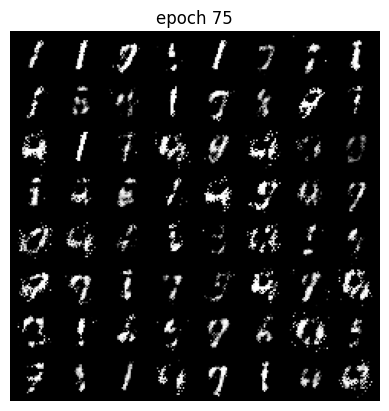

Epoch 75 of 100
Generator loss: 0.35633800, Discriminator loss: 0.68635194


118it [00:17,  6.67it/s]                         


Epoch 76 of 100
Generator loss: 0.35101549, Discriminator loss: 0.71128352


118it [00:16,  7.13it/s]                         


Epoch 77 of 100
Generator loss: 0.34193151, Discriminator loss: 0.73002794


118it [00:16,  7.27it/s]                         


Epoch 78 of 100
Generator loss: 0.34449915, Discriminator loss: 0.75834389


118it [00:16,  7.02it/s]                         


Epoch 79 of 100
Generator loss: 0.33292976, Discriminator loss: 0.75635367


118it [00:16,  7.33it/s]                         


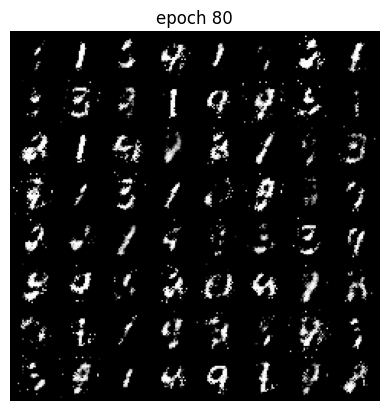

Epoch 80 of 100
Generator loss: 0.33288284, Discriminator loss: 0.78817232


118it [00:16,  7.28it/s]                         


Epoch 81 of 100
Generator loss: 0.32083317, Discriminator loss: 0.83561780


118it [00:16,  7.30it/s]                         


Epoch 82 of 100
Generator loss: 0.31496702, Discriminator loss: 0.82897402


118it [00:16,  7.11it/s]                         


Epoch 83 of 100
Generator loss: 0.34582969, Discriminator loss: 0.72106800


118it [00:16,  7.36it/s]                         


Epoch 84 of 100
Generator loss: 0.33936105, Discriminator loss: 0.74728683


118it [00:16,  7.31it/s]                         


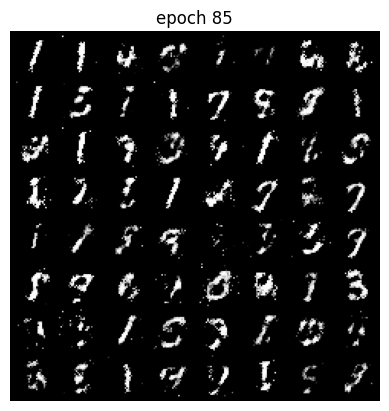

Epoch 85 of 100
Generator loss: 0.34635572, Discriminator loss: 0.69817704


118it [00:16,  7.16it/s]                         


Epoch 86 of 100
Generator loss: 0.34437101, Discriminator loss: 0.71280308


118it [00:16,  7.08it/s]                         


Epoch 87 of 100
Generator loss: 0.35141126, Discriminator loss: 0.68358929


118it [00:16,  7.34it/s]                         


Epoch 88 of 100
Generator loss: 0.34204391, Discriminator loss: 0.73793839


118it [00:16,  7.28it/s]                         


Epoch 89 of 100
Generator loss: 0.34616346, Discriminator loss: 0.72319028


118it [00:16,  6.99it/s]                         


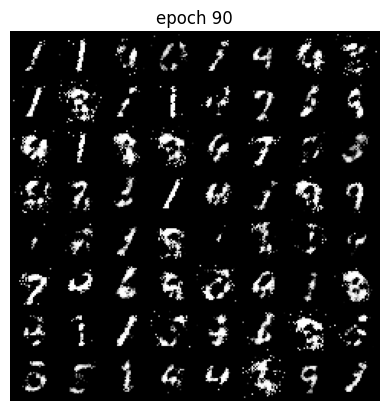

Epoch 90 of 100
Generator loss: 0.32669193, Discriminator loss: 0.78573595


118it [00:16,  7.14it/s]                         


Epoch 91 of 100
Generator loss: 0.32942240, Discriminator loss: 0.77347453


118it [00:17,  6.88it/s]                         


Epoch 92 of 100
Generator loss: 0.31531637, Discriminator loss: 0.81066242


118it [00:16,  7.00it/s]                         


Epoch 93 of 100
Generator loss: 0.32435128, Discriminator loss: 0.79988291


118it [00:16,  7.26it/s]                         


Epoch 94 of 100
Generator loss: 0.30599848, Discriminator loss: 0.85102479


118it [00:16,  7.31it/s]                         


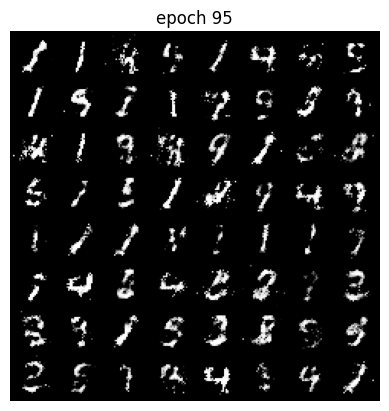

Epoch 95 of 100
Generator loss: 0.30494760, Discriminator loss: 0.86954691


118it [00:16,  7.27it/s]                         


Epoch 96 of 100
Generator loss: 0.30766957, Discriminator loss: 0.85761723


118it [00:17,  6.87it/s]                         


Epoch 97 of 100
Generator loss: 0.30734519, Discriminator loss: 0.86663214


118it [00:16,  7.23it/s]                         


Epoch 98 of 100
Generator loss: 0.29499085, Discriminator loss: 0.89450190


118it [00:16,  7.29it/s]                         


Epoch 99 of 100
Generator loss: 0.29693846, Discriminator loss: 0.90342390


118it [00:16,  7.27it/s]                         


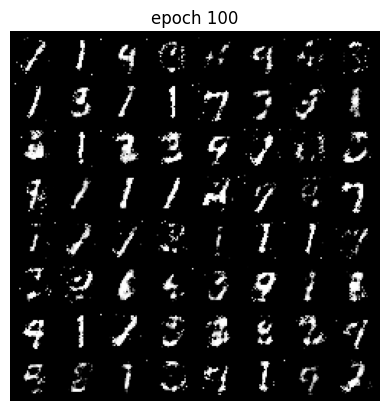

Epoch 100 of 100
Generator loss: 0.30423845, Discriminator loss: 0.87826518


In [8]:
from torch.nn.modules.distance import PairwiseDistance
torch.manual_seed(7777)

def label_real2(size):
    data = torch.ones(size, 1)*0.999
    return data.to(device)

# to create fake labels (0s)
def label_fake2(size):
    data = torch.ones(size, 1)*0.001
    return data.to(device)

def generator_loss(output, true_label):
  #BCE so that the update rule in the slide that prevents gradient vanishing aligns with original;
  #discriminating between 0 and 1 (fake and real)
  return criterion(output,true_label)

def discriminator_loss(output, true_label):
  return criterion(output,true_label)


for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ##########
        # Update discriminators
        discriminator.zero_grad()
        #clear out previous grad
        real_cpu = data[0].to(device)
        tr_noise = create_noise(len(real_cpu), nz)

        #GIVEN the generator
        generated = generator(tr_noise)
        real_output = discriminator(real_cpu)
        label = label_real(len(real_cpu))
        errD_real = discriminator_loss(real_output, label)
        errD_real.backward()

        #train w fake

        #Gradient ascent? improving discriminator with a generator fixed
        gen_output = discriminator(generated) #outputs prob [0,1] given generated images
        errD_fake = generator_loss(gen_output,label_fake(len(generated)))
        errD_fake.backward() #compute gradients
        errD = errD_real + errD_fake
        optim_d.step() #update zmodel params based on the gradient

        loss_d += errD.item()

        #Gradient descent: improving generator with discriminator fixed
        generator.zero_grad()
        tr_noise2 = create_noise(len(real_cpu), nz)
        fake2 = generator(tr_noise2)
        gen_output2 = discriminator(fake2)
        label2 = label_real(len(real_cpu))
        #errG = criterion(gen_output2,label2) #update rule in the slide to prevent vanishing gradient
        #changing in loss fct
        errG = 0.5*torch.mean((gen_output2-label2)**2) #MSE
        errG.backward()
        optim_g.step()

        loss_g += errG.item()
        ######################################


    # create the final fake image for the epoch
    generated_img = generator(noise).cpu().detach()

    # make the images as grid
    generated_img = make_grid(generated_img)

    # visualize generated images
    if epoch==0 or (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()

    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)

    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")

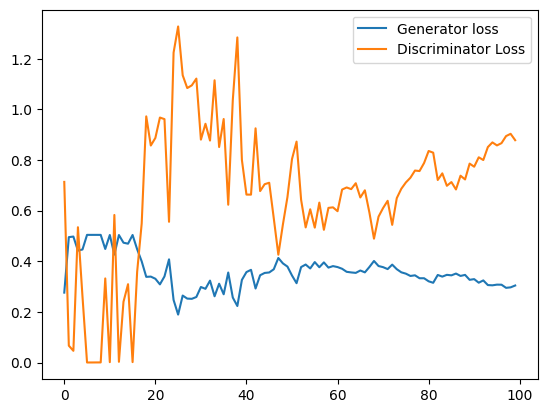

In [9]:
# Create a tensor and a matrix
tensor = np.random.rand(512, 1)  # Example 512x1 tensor
matrix = np.random.rand(128, 256)  # Example 128x256 matrix

# Reshape the tensor to match the size for multiplication
reshaped_tensor = tensor.reshape(4, 128)

# Perform matrix multiplication
result = np.dot(reshaped_tensor, matrix)

# save the generated images as GIF file
torch.save(generator.state_dict(), 'outputs/generator.pth')
imgs = [np.array(to_pil_image(img)) for img in images]
imageio.mimsave('outputs/generator_images.gif', imgs)
# plot and save the generator and discriminator loss
plt.figure()
plt.plot(losses_g, label='Generator loss')
plt.plot(losses_d, label='Discriminator Loss')
plt.legend()
plt.savefig('outputs/loss.png')

118it [00:19,  6.06it/s]                         


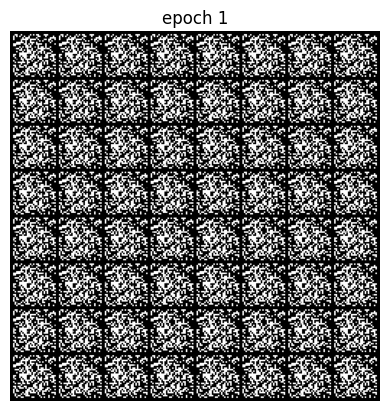

Epoch 1 of 100
Generator loss: 3.94497958, Discriminator loss: 0.56542832


118it [00:16,  6.97it/s]                         


Epoch 2 of 100
Generator loss: 2.75156673, Discriminator loss: 0.37282703


118it [00:15,  7.38it/s]                         


Epoch 3 of 100
Generator loss: 2.44803100, Discriminator loss: 0.34975078


118it [00:15,  7.38it/s]                         


Epoch 4 of 100
Generator loss: 2.37243148, Discriminator loss: 0.34286906


118it [00:16,  7.15it/s]                         


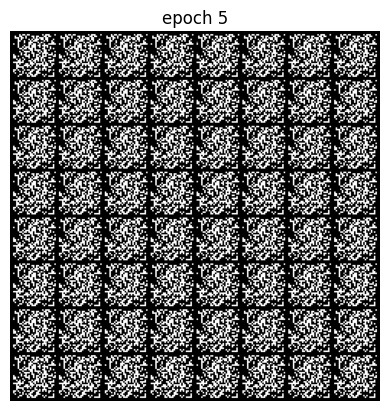

Epoch 5 of 100
Generator loss: 2.35445496, Discriminator loss: 0.34012481


118it [00:16,  7.36it/s]                         


Epoch 6 of 100
Generator loss: 2.34463587, Discriminator loss: 0.33892402


118it [00:16,  7.03it/s]                         


Epoch 7 of 100
Generator loss: 2.34438267, Discriminator loss: 0.33818083


118it [00:16,  7.16it/s]                         


Epoch 8 of 100
Generator loss: 2.34266677, Discriminator loss: 0.33760432


118it [00:16,  7.32it/s]                         


Epoch 9 of 100
Generator loss: 2.33923251, Discriminator loss: 0.33714565


118it [00:16,  7.34it/s]                         


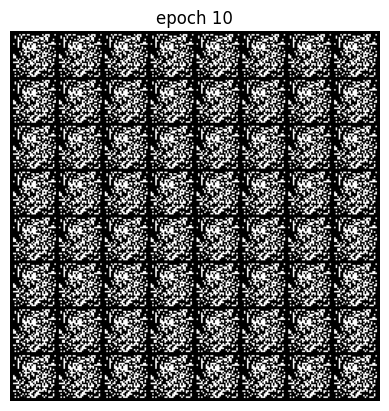

Epoch 10 of 100
Generator loss: 2.34043094, Discriminator loss: 0.33699640


118it [00:16,  7.27it/s]                         


Epoch 11 of 100
Generator loss: 2.33667720, Discriminator loss: 0.33668586


118it [00:16,  7.23it/s]                         


Epoch 12 of 100
Generator loss: 2.33693137, Discriminator loss: 0.33638554


118it [00:16,  7.14it/s]                         


Epoch 13 of 100
Generator loss: 2.33676460, Discriminator loss: 0.33619405


118it [00:17,  6.88it/s]                         


Epoch 14 of 100
Generator loss: 2.33322910, Discriminator loss: 0.33603592


118it [00:16,  7.29it/s]                         


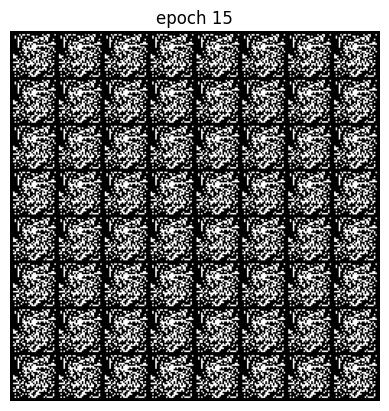

Epoch 15 of 100
Generator loss: 2.33386723, Discriminator loss: 0.33591925


118it [00:16,  6.97it/s]                         


Epoch 16 of 100
Generator loss: 2.33721026, Discriminator loss: 0.33593657


118it [00:16,  7.25it/s]                         


Epoch 17 of 100
Generator loss: 2.33527856, Discriminator loss: 0.33575891


118it [00:16,  7.21it/s]                         


Epoch 18 of 100
Generator loss: 2.33307064, Discriminator loss: 0.33569045


118it [00:16,  7.00it/s]                         


Epoch 19 of 100
Generator loss: 2.33468220, Discriminator loss: 0.33569732


118it [00:16,  6.99it/s]                         


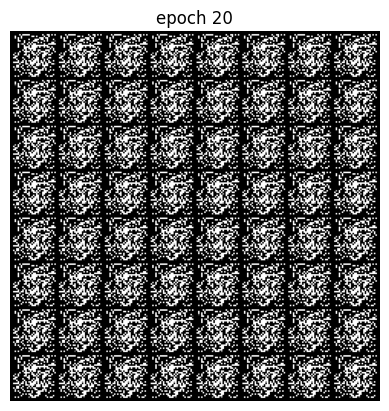

Epoch 20 of 100
Generator loss: 2.33479523, Discriminator loss: 0.33560259


118it [00:16,  7.09it/s]                         


Epoch 21 of 100
Generator loss: 2.33829193, Discriminator loss: 0.33578374


118it [00:16,  7.10it/s]                         


Epoch 22 of 100
Generator loss: 2.35578229, Discriminator loss: 0.33619563


118it [00:16,  7.07it/s]                         


Epoch 23 of 100
Generator loss: 2.87912448, Discriminator loss: 0.35526634


118it [00:16,  7.07it/s]                         


Epoch 24 of 100
Generator loss: 2.46410123, Discriminator loss: 0.34322699


118it [00:17,  6.87it/s]                         


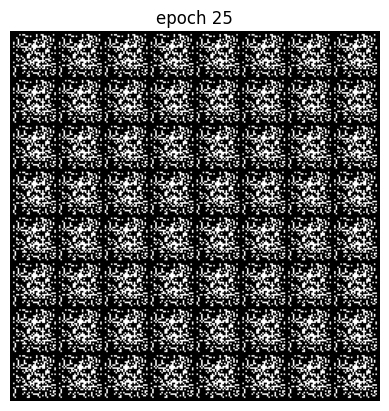

Epoch 25 of 100
Generator loss: 2.34239777, Discriminator loss: 0.33790945


118it [00:16,  6.97it/s]                         


Epoch 26 of 100
Generator loss: 2.33377868, Discriminator loss: 0.33674368


118it [00:17,  6.88it/s]                         


Epoch 27 of 100
Generator loss: 2.33240231, Discriminator loss: 0.33626739


118it [00:16,  6.95it/s]                         


Epoch 28 of 100
Generator loss: 2.33374986, Discriminator loss: 0.33597530


118it [00:17,  6.84it/s]                         


Epoch 29 of 100
Generator loss: 2.33096393, Discriminator loss: 0.33582352


118it [00:18,  6.48it/s]                         


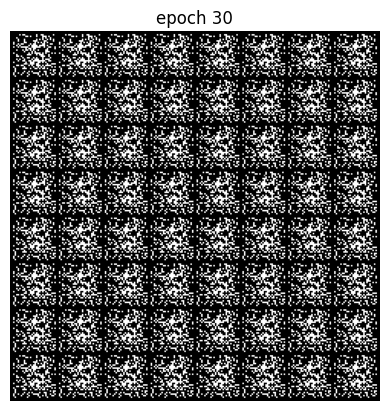

Epoch 30 of 100
Generator loss: 2.33337301, Discriminator loss: 0.33561536


118it [00:17,  6.74it/s]                         


Epoch 31 of 100
Generator loss: 2.33150392, Discriminator loss: 0.33552687


118it [00:17,  6.90it/s]                         


Epoch 32 of 100
Generator loss: 2.33134389, Discriminator loss: 0.33539218


118it [00:17,  6.87it/s]                         


Epoch 33 of 100
Generator loss: 2.33033028, Discriminator loss: 0.33530665


118it [00:17,  6.78it/s]                         


Epoch 34 of 100
Generator loss: 2.33136150, Discriminator loss: 0.33521661


118it [00:17,  6.63it/s]                         


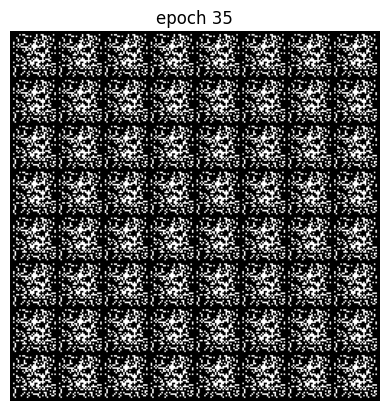

Epoch 35 of 100
Generator loss: 2.32937342, Discriminator loss: 0.33514525


118it [00:17,  6.64it/s]                         


Epoch 36 of 100
Generator loss: 2.33023341, Discriminator loss: 0.33508985


118it [00:17,  6.69it/s]                         


Epoch 37 of 100
Generator loss: 2.32992788, Discriminator loss: 0.33504697


118it [00:17,  6.71it/s]                         


Epoch 38 of 100
Generator loss: 2.32885454, Discriminator loss: 0.33498043


118it [00:17,  6.72it/s]                         


Epoch 39 of 100
Generator loss: 2.32999194, Discriminator loss: 0.33495606


118it [00:18,  6.47it/s]                         


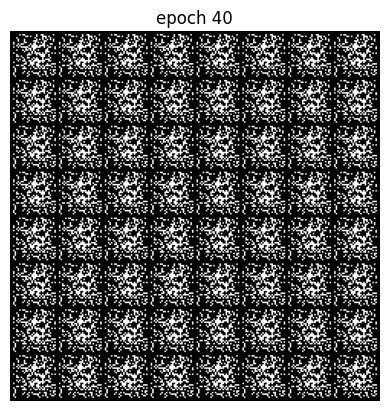

Epoch 40 of 100
Generator loss: 2.32974936, Discriminator loss: 0.33491147


118it [00:17,  6.63it/s]                         


Epoch 41 of 100
Generator loss: 2.33030554, Discriminator loss: 0.33488237


118it [00:17,  6.73it/s]                         


Epoch 42 of 100
Generator loss: 2.32934847, Discriminator loss: 0.33484144


118it [00:17,  6.75it/s]                         


Epoch 43 of 100
Generator loss: 2.33003450, Discriminator loss: 0.33478908


118it [00:17,  6.62it/s]                         


Epoch 44 of 100
Generator loss: 2.32798297, Discriminator loss: 0.33476965


118it [00:18,  6.46it/s]                         


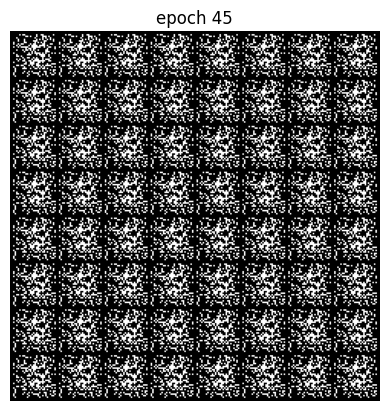

Epoch 45 of 100
Generator loss: 2.33056648, Discriminator loss: 0.33474373


118it [00:17,  6.56it/s]                         


Epoch 46 of 100
Generator loss: 2.32932090, Discriminator loss: 0.33471893


118it [00:17,  6.74it/s]                         


Epoch 47 of 100
Generator loss: 2.32953685, Discriminator loss: 0.33471209


118it [00:17,  6.73it/s]                         


Epoch 48 of 100
Generator loss: 2.32944815, Discriminator loss: 0.33467713


118it [00:17,  6.69it/s]                         


Epoch 49 of 100
Generator loss: 2.33006277, Discriminator loss: 0.33463634


118it [00:18,  6.51it/s]                         


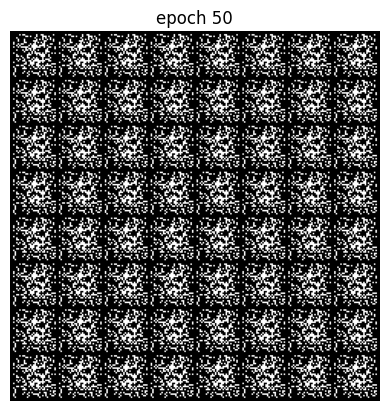

Epoch 50 of 100
Generator loss: 2.33009227, Discriminator loss: 0.33463215


118it [00:18,  6.37it/s]                         


Epoch 51 of 100
Generator loss: 2.32859713, Discriminator loss: 0.33459899


118it [00:17,  6.64it/s]                         


Epoch 52 of 100
Generator loss: 2.32972423, Discriminator loss: 0.33460447


118it [00:17,  6.58it/s]                         


Epoch 53 of 100
Generator loss: 2.32915226, Discriminator loss: 0.33456444


118it [00:18,  6.56it/s]                         


Epoch 54 of 100
Generator loss: 2.32843469, Discriminator loss: 0.33456072


118it [00:18,  6.35it/s]                         


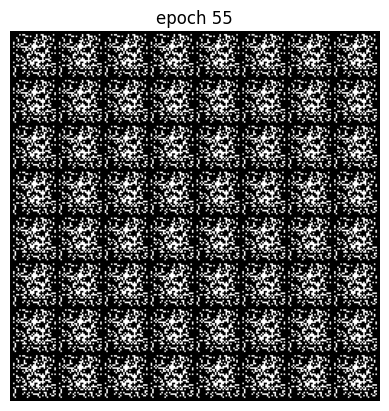

Epoch 55 of 100
Generator loss: 2.33038572, Discriminator loss: 0.33452303


118it [00:18,  6.28it/s]                         


Epoch 56 of 100
Generator loss: 2.32897187, Discriminator loss: 0.33450114


118it [00:18,  6.51it/s]                         


Epoch 57 of 100
Generator loss: 2.32966285, Discriminator loss: 0.33448667


118it [00:18,  6.49it/s]                         


Epoch 58 of 100
Generator loss: 2.32948608, Discriminator loss: 0.33449084


118it [00:18,  6.53it/s]                         


Epoch 59 of 100
Generator loss: 2.32949803, Discriminator loss: 0.33447450


118it [00:18,  6.28it/s]                         


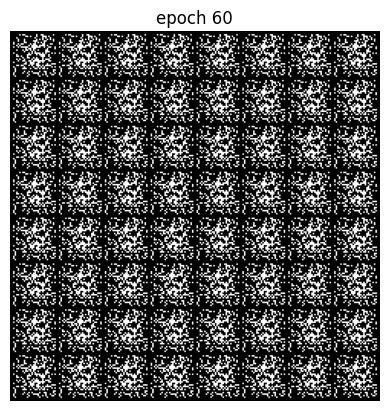

Epoch 60 of 100
Generator loss: 2.32830628, Discriminator loss: 0.33446126


118it [00:18,  6.32it/s]                         


Epoch 61 of 100
Generator loss: 2.32900847, Discriminator loss: 0.33442757


118it [00:18,  6.35it/s]                         


Epoch 62 of 100
Generator loss: 2.32853491, Discriminator loss: 0.33441156


118it [00:18,  6.48it/s]                         


Epoch 63 of 100
Generator loss: 2.32839389, Discriminator loss: 0.33440282


118it [00:18,  6.46it/s]                         


Epoch 64 of 100
Generator loss: 2.32953129, Discriminator loss: 0.33436725


118it [00:19,  6.14it/s]                         


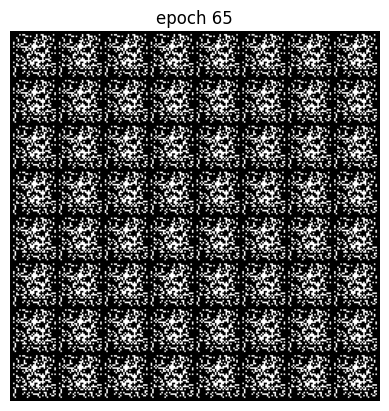

Epoch 65 of 100
Generator loss: 2.32911220, Discriminator loss: 0.33438251


118it [00:18,  6.37it/s]                         


Epoch 66 of 100
Generator loss: 2.32968563, Discriminator loss: 0.33436103


118it [00:18,  6.42it/s]                         


Epoch 67 of 100
Generator loss: 2.32947158, Discriminator loss: 0.33433859


118it [00:18,  6.52it/s]                         


Epoch 68 of 100
Generator loss: 2.32902332, Discriminator loss: 0.33433741


118it [00:18,  6.42it/s]                         


Epoch 69 of 100
Generator loss: 2.32806362, Discriminator loss: 0.33432599


118it [00:18,  6.24it/s]                         


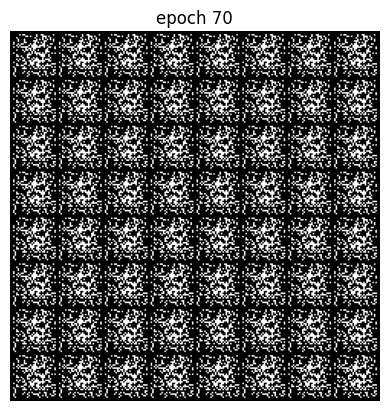

Epoch 70 of 100
Generator loss: 2.32974949, Discriminator loss: 0.33430604


118it [00:19,  6.11it/s]                         


Epoch 71 of 100
Generator loss: 2.32914244, Discriminator loss: 0.33430067


118it [00:18,  6.31it/s]                         


Epoch 72 of 100
Generator loss: 2.32934540, Discriminator loss: 0.33429574


118it [00:18,  6.31it/s]                         


Epoch 73 of 100
Generator loss: 2.32886773, Discriminator loss: 0.33430915


118it [00:18,  6.32it/s]                         


Epoch 74 of 100
Generator loss: 2.32872155, Discriminator loss: 0.33430342


118it [00:19,  6.12it/s]                         


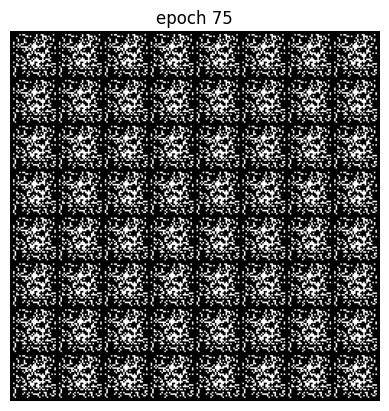

Epoch 75 of 100
Generator loss: 2.32868183, Discriminator loss: 0.33428485


118it [00:18,  6.28it/s]                         


Epoch 76 of 100
Generator loss: 2.32929730, Discriminator loss: 0.33425180


118it [00:19,  6.14it/s]                         


Epoch 77 of 100
Generator loss: 2.32965925, Discriminator loss: 0.33424172


118it [00:18,  6.37it/s]                         


Epoch 78 of 100
Generator loss: 2.32883540, Discriminator loss: 0.33424146


118it [00:18,  6.25it/s]                         


Epoch 79 of 100
Generator loss: 2.33011253, Discriminator loss: 0.33423715


118it [00:18,  6.26it/s]                         


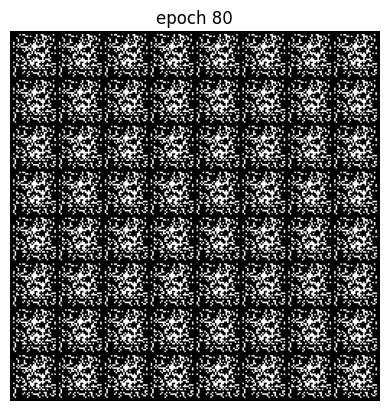

Epoch 80 of 100
Generator loss: 2.32944899, Discriminator loss: 0.33422193


118it [00:19,  6.04it/s]                         


Epoch 81 of 100
Generator loss: 2.33014622, Discriminator loss: 0.33424306


118it [00:19,  6.05it/s]                         


Epoch 82 of 100
Generator loss: 2.38537416, Discriminator loss: 0.33568845


118it [00:18,  6.28it/s]                         


Epoch 83 of 100
Generator loss: 2.37335338, Discriminator loss: 0.33584255


118it [00:18,  6.26it/s]                         


Epoch 84 of 100
Generator loss: 2.33991177, Discriminator loss: 0.33513778


118it [00:18,  6.31it/s]                         


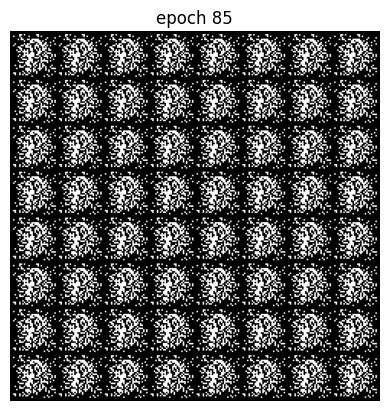

Epoch 85 of 100
Generator loss: 2.33732070, Discriminator loss: 0.33484735


118it [00:19,  5.99it/s]                         


Epoch 86 of 100
Generator loss: 2.33430569, Discriminator loss: 0.33460367


118it [00:19,  6.06it/s]                         


Epoch 87 of 100
Generator loss: 2.33442102, Discriminator loss: 0.33461828


118it [00:18,  6.25it/s]                         


Epoch 88 of 100
Generator loss: 2.33640299, Discriminator loss: 0.33452434


118it [00:18,  6.22it/s]                         


Epoch 89 of 100
Generator loss: 2.35956575, Discriminator loss: 0.33506233


118it [00:18,  6.26it/s]                         


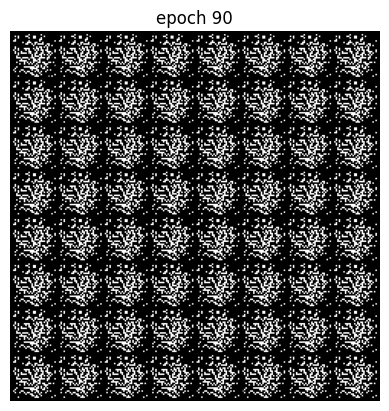

Epoch 90 of 100
Generator loss: 2.35446118, Discriminator loss: 0.33521950


118it [00:19,  6.16it/s]                         


Epoch 91 of 100
Generator loss: 2.34234283, Discriminator loss: 0.33486861


118it [00:20,  5.73it/s]                         


Epoch 92 of 100
Generator loss: 2.33723436, Discriminator loss: 0.33469542


118it [00:19,  6.11it/s]                         


Epoch 93 of 100
Generator loss: 2.33624303, Discriminator loss: 0.33463287


 29%|██▉       | 34/117 [00:05<00:12,  6.52it/s]

In [ ]:
from torch.nn.modules.distance import PairwiseDistance
torch.manual_seed(7777)
def weights_init_he(m):
    classname = m.__class__.__name__
    if classname.find('Linear') != -1:
        nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
        if m.bias is not None:
            nn.init.constant_(m.bias.data, 0)
    elif classname.find('Conv') != -1:
        nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
        if m.bias is not None:
            nn.init.constant_(m.bias.data, 0)

generator3 = Generator(nz).to(device)
discriminator3 = Discriminator().to(device)

generator3.apply(weights_init_he)
discriminator3.apply(weights_init_he)

optim_g3 = optim.Adam(generator3.parameters(), lr=0.0002, betas=(0.95,0.999))
optim_d3 = optim.Adam(discriminator3.parameters(), lr=0.0002, betas=(0.95,0.999))

def label_real2(size):
    data = torch.ones(size, 1)*0.999
    return data.to(device)

# to create fake labels (0s)
def label_fake2(size):
    data = torch.ones(size, 1)*0.099
    return data.to(device)

def generator_loss(output, true_label):
  #BCE so that the update rule in the slide that prevents gradient vanishing aligns with original;
  #discriminating between 0 and 1 (fake and real)
  return criterion(output,true_label)

def discriminator_loss(output, true_label):
  return criterion(output,true_label)


for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ##########
        # Update discriminators
        discriminator3.zero_grad()
        #clear out previous grad
        real_cpu = data[0].to(device)
        tr_noise = create_noise(len(real_cpu), nz)

        #GIVEN the generator
        generated = generator3(tr_noise)
        real_output = discriminator3(real_cpu)
        label = label_real2(len(real_cpu))
        errD_real = discriminator_loss(real_output, label)
        errD_real.backward()

        #train w fake

        #Gradient ascent? improving discriminator with a generator fixed
        gen_output = discriminator3(generated) #outputs prob [0,1] given generated images
        errD_fake = generator_loss(gen_output,label_fake2(len(generated)))
        errD_fake.backward() #compute gradients
        errD = errD_real + errD_fake
        optim_d3.step() #update model params based on the gradient

        loss_d += errD.item()

        #Gradient descent: improving generator with discriminator fixed
        generator3.zero_grad()
        tr_noise2 = create_noise(len(real_cpu), nz)
        fake2 = generator3(tr_noise2)
        gen_output2 = discriminator3(fake2)
        label2 = label_real2(len(real_cpu))
        errG = criterion(gen_output2,label2) #update rule in the slide to prevent vanishing gradient
        errG.backward()
        optim_g3.step()

        loss_g += errG.item()
        ######################################


    # create the final fake image for the epoch
    generated_img = generator3(noise).cpu().detach()

    # make the images as grid
    generated_img = make_grid(generated_img)

    # visualize generated images
    if epoch==0 or (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()

    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)

    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")